In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
!pip install phik

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
%matplotlib inline
from scipy import stats
import warnings
warnings.filterwarnings('ignore')
import matplotlib.gridspec as gridspec

import itertools
import phik
from phik import resources
from phik.binning import bin_data
from phik.report import plot_correlation_matrix
%matplotlib inline

In [4]:
data = df = pd.read_csv("/content/drive/MyDrive/case study 1/aps_failure_training_set.csv", na_values='na')
data.head()

,class,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,ag_003,ag_004,ag_005,ag_006,ag_007,ag_008,ag_009,ah_000,ai_000,aj_000,ak_000,al_000,am_0,an_000,ao_000,ap_000,aq_000,ar_000,as_000,at_000,au_000,av_000,ax_000,ay_000,ay_001,ay_002,ay_003,ay_004,ay_005,ay_006,...,db_000,dc_000,dd_000,de_000,df_000,dg_000,dh_000,di_000,dj_000,dk_000,dl_000,dm_000,dn_000,do_000,dp_000,dq_000,dr_000,ds_000,dt_000,du_000,dv_000,dx_000,dy_000,dz_000,ea_000,eb_000,ec_00,ed_000,ee_000,ee_001,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,neg,76698,NaN,2.130706e+09,280.0,0.0,0.0,0.0,0.0,0.0,0.0,37250.0,1432864.0,3664156.0,1007684.0,25896.0,0.0,2551696.0,0.0,0.0,0.0,0.0,0.0,4933296.0,3655166.0,1766008.0,1132040.0,0.0,0.0,0.0,0.0,1012.0,268.0,0.0,0.0,0.0,0.0,0.0,469014.0,4239660.0,...,18.0,5330690.0,4732.0,1126.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,62282.0,85908.0,32790.0,0.0,0.0,202710.0,37928.0,14745580.0,1876644.0,0.0,0.0,0.0,0.0,2801180.0,2445.80,2712.0,965866.0,1706908.0,1240520.0,493384.0,721044.0,469792.0,339156.0,157956.0,73224.0,0.0,0.0,0.0
1,neg,33058,NaN,0.000000e+00,NaN,0.0,0.0,0.0,0.0,0.0,0.0,18254.0,653294.0,1720800.0,516724.0,31642.0,0.0,1393352.0,0.0,68.0,0.0,0.0,0.0,2560898.0,2127150.0,1084598.0,338544.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,71510.0,772720.0,...,NaN,NaN,3312.0,522.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,33736.0,36946.0,5936.0,0.0,0.0,103330.0,16254.0,4510080.0,868538.0,0.0,0.0,0.0,0.0,3477820.0,2211.76,2334.0,664504.0,824154.0,421400.0,178064.0,293306.0,245416.0,133654.0,81140.0,97576.0,1500.0,0.0,0.0
2,neg,41040,NaN,2.280000e+02,100.0,0.0,0.0,0.0,0.0,0.0,0.0,1648.0,370592.0,1883374.0,292936.0,12016.0,0.0,1234132.0,0.0,0.0,0.0,0.0,0.0,2371990.0,2173634.0,300796.0,153698.0,0.0,0.0,0.0,0.0,358.0,110.0,0.0,0.0,0.0,0.0,0.0,0.0,870456.0,...,0.0,2341048.0,1494.0,152.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,13876.0,38182.0,8138.0,0.0,0.0,65772.0,10534.0,300240.0,48028.0,0.0,0.0,0.0,0.0,1040120.0,1018.64,1020.0,262032.0,453378.0,277378.0,159812.0,423992.0,409564.0,320746.0,158022.0,95128.0,514.0,0.0,0.0
3,neg,12,0.0,7.000000e+01,66.0,0.0,10.0,0.0,0.0,0.0,318.0,2212.0,3232.0,1872.0,0.0,0.0,0.0,2668.0,0.0,0.0,0.0,642.0,3894.0,10184.0,7554.0,10764.0,1014.0,0.0,0.0,0.0,0.0,60.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,2578.0,76.0,62.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,232.0,0.0,0.0,2014.0,370.0,48.0,18.0,15740.0,1822.0,20174.0,44.0,0.0,0.0,0.0,1.08,54.0,5670.0,1566.0,240.0,46.0,58.0,44.0,10.0,0.0,0.0,0.0,4.0,32.0
4,neg,60874,NaN,1.368000e+03,458.0,0.0,0.0,0.0,0.0,0.0,0.0,43752.0,1966618.0,1800340.0,131646.0,4588.0,0.0,1974038.0,0.0,226.0,0.0,0.0,0.0,3230626.0,2618878.0,1058136.0,551022.0,0.0,0.0,0.0,0.0,1788.0,642.0,0.0,0.0,0.0,0.0,42124.0,372236.0,2128914.0,...,0.0,3590004.0,2026.0,444.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,44946.0,62648.0,11506.0,0.0,0.0,149474.0,35154.0,457040.0,80482.0,98334.0,27588.0,0.0,0.0,21173050.0,1116.06,1176.0,404740.0,904230.0,622012.0,229790.0,405298.0,347188.0,286954.0,311560.0,433954.0,1218.0,0.0,0.0


In [5]:
data.shape

(60000, 171)

In [6]:
data.describe()

,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,ag_003,ag_004,ag_005,ag_006,ag_007,ag_008,ag_009,ah_000,ai_000,aj_000,ak_000,al_000,am_0,an_000,ao_000,ap_000,aq_000,ar_000,as_000,at_000,au_000,av_000,ax_000,ay_000,ay_001,ay_002,ay_003,ay_004,ay_005,ay_006,ay_007,...,db_000,dc_000,dd_000,de_000,df_000,dg_000,dh_000,di_000,dj_000,dk_000,dl_000,dm_000,dn_000,do_000,dp_000,dq_000,dr_000,ds_000,dt_000,du_000,dv_000,dx_000,dy_000,dz_000,ea_000,eb_000,ec_00,ed_000,ee_000,ee_001,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
count,6.000000e+04,13671.000000,5.666500e+04,4.513900e+04,57500.000000,57500.000000,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.935500e+04,5.937100e+04,5.937100e+04,5.560000e+04,5.935800e+04,5.937100e+04,5.935800e+04,5.941100e+04,5.935800e+04,5.941100e+04,57277.000000,5.937100e+04,5.937100e+04,5.937100e+04,57500.000000,57499.000000,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,...,46192.000000,4.619200e+04,57497.000000,57276.000000,5.599200e+04,5.599200e+04,5.599200e+04,5.599400e+04,55993.000000,5.599300e+04,5.599200e+04,5.599100e+04,5.930900e+04,5.727600e+04,57274.000000,5.727400e+04,5.727400e+04,5.727300e+04,57273.000000,5.727400e+04,5.727400e+04,5.727700e+04,5.727600e+04,57277.000000,57277.000000,5.599300e+04,49761.000000,50447.000000,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,5.932900e+04,57276.000000,57277.000000
mean,5.933650e+04,0.713189,3.560143e+08,1.906206e+05,6.819130,11.006817,2.216364e+02,9.757223e+02,8.606015e+03,8.859128e+04,4.370966e+05,1.108374e+06,1.657818e+06,4.993098e+05,3.556989e+04,5.114753e+03,1.809931e+06,9.016965e+03,1.143675e+03,9.794900e+02,5.913048e+04,9.328133e+04,3.461037e+06,3.002440e+06,1.004160e+06,4.424045e+05,0.496918,1.267365e+02,5.072046e+03,2.305804e+02,1117.825913,374.327380,1.221165e+04,1.019012e+04,1.097500e+04,7.225784e+03,1.056600e+04,1.119791e+05,1.078551e+06,1.546032e+06,...,13.416652,2.200752e+06,3123.961911,375.147112,2.718638e+03,5.609957e+03,4.707073e+03,3.724824e+04,39.938564,1.861313e+03,2.854177e+04,7.923228e+03,3.374545e+04,2.850785e+04,6958.652722,4.529375e+06,2.037598e+05,8.965500e+04,15403.354670,4.058712e+06,5.938350e+05,7.912085e+05,7.780350e+03,0.215759,1.567750,9.717093e+06,1353.131452,1452.155212,7.334042e+05,7.838746e+05,4.454897e+05,2.111264e+05,4.457343e+05,3.939462e+05,3.330582e+05,3.462714e+05,1.387300e+05,8.388915e+03,0.090579,0.212756
std,1.454301e+05,3.478962,7.948749e+08,4.040441e+07,161.543373,209.792592,2.047846e+04,3.420053e+04,1.503220e+05,7.617312e+05,2.374282e+06,3.262607e+06,3.909384e+06,1.422765e+06,2.201524e+05,1.696582e+05,4.185740e+06,1.632778e+05,5.035971e+04,7.583162e+04,5.394658e+05,8.494694e+05,7.790350e+06,6.819518e+06,3.088457e+06,1.262469e+06,5.511653,1.101004e+04,1.196159e+05,1.579952e+04,6598.611557,1482.711621,4.544963e+05,5.352707e+05,4.283370e+05,2.064679e+05,3.546258e+05,1.394585e+06,3.278941e+06,5.106177e+06,...,73.405610,4.110150e+06,9516.675102,1689.062059,1.373331e+05,2.085649e+05,5.602799e+05,4.254382e+05,4533.142182,6.659786e+04,1.095662e+06,2.775356e+05,9.733719e+04,6.125476e+04,13955.451781,9.748478e+07,1.366065e+06,2.082016e+05,33801.022975,1.156777e+07,2.082998e+06,4.151033e+06,5.924449e+04,10.821035,53.528722,4.274675e+07,3536.637285,3525.028652,2.416166e+06,2.570111e+06,1.155540e+06,5.433188e+05,1.168314e+06,1.121044e+06,1.069160e+06,1.728056e+06,4.495100e+05,4.747043e+04,4.368855,8.830641
min,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000e+00,0.000000e+00,0.000000

In [7]:
print("Columns name :\n",list(data.columns))

Columns name :
 ['class', 'aa_000', 'ab_000', 'ac_000', 'ad_000', 'ae_000', 'af_000', 'ag_000', 'ag_001', 'ag_002', 'ag_003', 'ag_004', 'ag_005', 'ag_006', 'ag_007', 'ag_008', 'ag_009', 'ah_000', 'ai_000', 'aj_000', 'ak_000', 'al_000', 'am_0', 'an_000', 'ao_000', 'ap_000', 'aq_000', 'ar_000', 'as_000', 'at_000', 'au_000', 'av_000', 'ax_000', 'ay_000', 'ay_001', 'ay_002', 'ay_003', 'ay_004', 'ay_005', 'ay_006', 'ay_007', 'ay_008', 'ay_009', 'az_000', 'az_001', 'az_002', 'az_003', 'az_004', 'az_005', 'az_006', 'az_007', 'az_008', 'az_009', 'ba_000', 'ba_001', 'ba_002', 'ba_003', 'ba_004', 'ba_005', 'ba_006', 'ba_007', 'ba_008', 'ba_009', 'bb_000', 'bc_000', 'bd_000', 'be_000', 'bf_000', 'bg_000', 'bh_000', 'bi_000', 'bj_000', 'bk_000', 'bl_000', 'bm_000', 'bn_000', 'bo_000', 'bp_000', 'bq_000', 'br_000', 'bs_000', 'bt_000', 'bu_000', 'bv_000', 'bx_000', 'by_000', 'bz_000', 'ca_000', 'cb_000', 'cc_000', 'cd_000', 'ce_000', 'cf_000', 'cg_000', 'ch_000', 'ci_000', 'cj_000', 'ck_000', 'cl_00

In [8]:
def missing_values_table(df):
        # Total missing values
        mis_val = df.isna().sum()
        
        # Percentage of missing values
        mis_val_percent = 100 * df.isnull().sum() / len(df)
        
        # Make a table with the results
        mis_val_table = pd.concat([mis_val, mis_val_percent], axis=1)
        
        # Rename the columns
        mis_val_table_ren_columns = mis_val_table.rename(
        columns = {0 : 'Missing Values', 1 : '% of Total Values'})
        
        # Sort the table by percentage of missing descending
        mis_val_table_ren_columns = mis_val_table_ren_columns[
            mis_val_table_ren_columns.iloc[:,1] != 0].sort_values(
        '% of Total Values', ascending=False).round(1)
        
        # Print some summary information
        print ("Your selected dataframe has " + str(df.shape[1]) + " columns.\n"      
            "There are " + str(mis_val_table_ren_columns.shape[0]) +
              " columns that have missing values.")
        
        # Return the dataframe with missing information
        return mis_val_table_ren_columns

In [9]:
data_missing =  missing_values_table(data)
data_missing.head(20)

Your selected dataframe has 171 columns.
There are 169 columns that have missing values.


,Missing Values,% of Total Values
br_000,49264,82.1
bq_000,48722,81.2
bp_000,47740,79.6
bo_000,46333,77.2
ab_000,46329,77.2
cr_000,46329,77.2
bn_000,44009,73.3
bm_000,39549,65.9
bl_000,27277,45.5
bk_000,23034,38.4


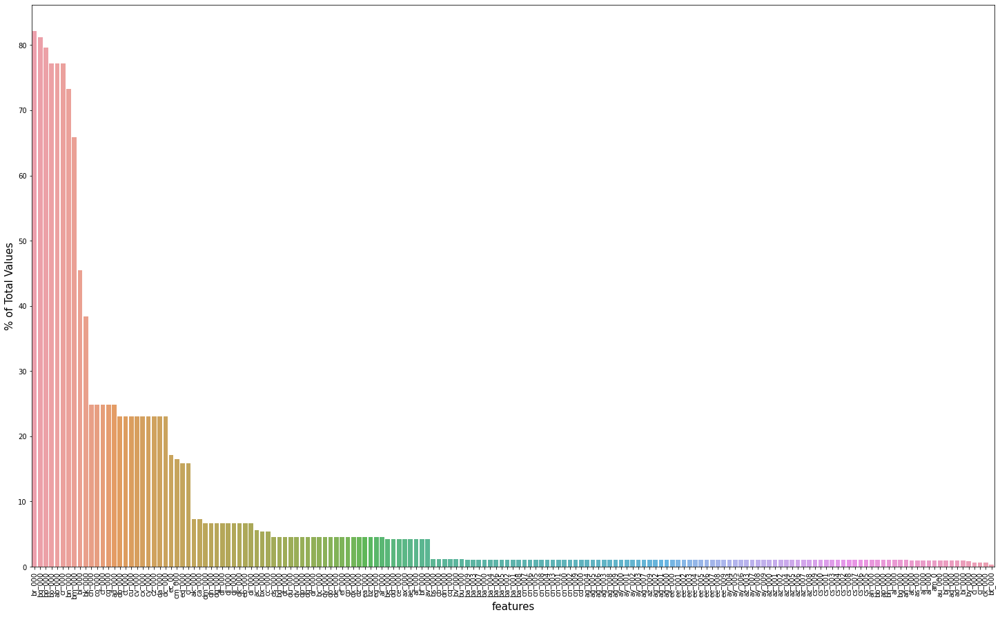

<Figure size 432x288 with 0 Axes>

In [10]:
plt.figure(figsize = (25,15))
sns.barplot(data_missing.index, data_missing['% of Total Values'], alpha = 0.9,order=data_missing.index)
plt.xticks(rotation = 'vertical')
plt.xlabel('features', fontsize =15)
plt.ylabel('% of Total Values', fontsize = 15)
plt.show()
plt.draw()

In [11]:
data = data_drop = data.drop(['br_000','bq_000','bp_000','bo_000','ab_000','cr_000','bn_000','bm_000'],axis=1)

In [12]:
data.shape

(60000, 163)

In [13]:
col = list(data.columns)

In [14]:
print ('The train data has {} unique labels'.format(df['class'].nunique()))

The train data has 2 unique labels


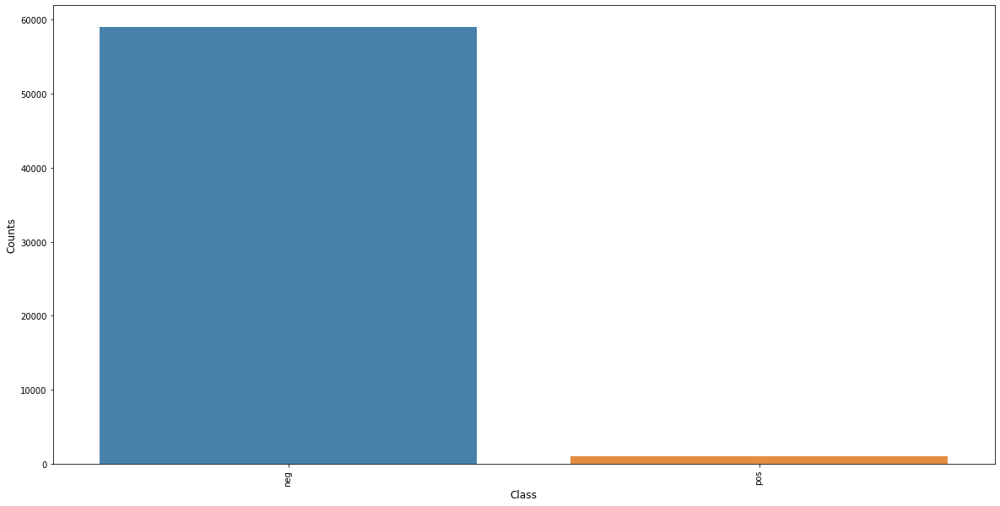

In [15]:
label_counts = df['class'].value_counts()
plt.figure(figsize = (20,10))
sns.barplot(label_counts.index, label_counts.values, alpha = 0.9)
plt.xticks(rotation = 'vertical')
plt.xlabel('Class', fontsize =12)
plt.ylabel('Counts', fontsize = 12)
plt.show()

In [16]:
print("Number of positive classes = ", sum(df['class'] == 'pos'))
print("Number of negative classes = ", sum(df['class'] == 'neg'))

Number of positive classes =  1000
Number of negative classes =  59000


In [17]:
X = data.drop("class",axis=1)
y = data['class']

In [18]:
data['class'] = data['class'].apply(lambda x: 0 if x == 'neg' else 1)
data.head()

,class,aa_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,ag_003,ag_004,ag_005,ag_006,ag_007,ag_008,ag_009,ah_000,ai_000,aj_000,ak_000,al_000,am_0,an_000,ao_000,ap_000,aq_000,ar_000,as_000,at_000,au_000,av_000,ax_000,ay_000,ay_001,ay_002,ay_003,ay_004,ay_005,ay_006,ay_007,...,db_000,dc_000,dd_000,de_000,df_000,dg_000,dh_000,di_000,dj_000,dk_000,dl_000,dm_000,dn_000,do_000,dp_000,dq_000,dr_000,ds_000,dt_000,du_000,dv_000,dx_000,dy_000,dz_000,ea_000,eb_000,ec_00,ed_000,ee_000,ee_001,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,0,76698,2.130706e+09,280.0,0.0,0.0,0.0,0.0,0.0,0.0,37250.0,1432864.0,3664156.0,1007684.0,25896.0,0.0,2551696.0,0.0,0.0,0.0,0.0,0.0,4933296.0,3655166.0,1766008.0,1132040.0,0.0,0.0,0.0,0.0,1012.0,268.0,0.0,0.0,0.0,0.0,0.0,469014.0,4239660.0,703300.0,...,18.0,5330690.0,4732.0,1126.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,62282.0,85908.0,32790.0,0.0,0.0,202710.0,37928.0,14745580.0,1876644.0,0.0,0.0,0.0,0.0,2801180.0,2445.80,2712.0,965866.0,1706908.0,1240520.0,493384.0,721044.0,469792.0,339156.0,157956.0,73224.0,0.0,0.0,0.0
1,0,33058,0.000000e+00,NaN,0.0,0.0,0.0,0.0,0.0,0.0,18254.0,653294.0,1720800.0,516724.0,31642.0,0.0,1393352.0,0.0,68.0,0.0,0.0,0.0,2560898.0,2127150.0,1084598.0,338544.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,71510.0,772720.0,1996924.0,...,NaN,NaN,3312.0,522.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,33736.0,36946.0,5936.0,0.0,0.0,103330.0,16254.0,4510080.0,868538.0,0.0,0.0,0.0,0.0,3477820.0,2211.76,2334.0,664504.0,824154.0,421400.0,178064.0,293306.0,245416.0,133654.0,81140.0,97576.0,1500.0,0.0,0.0
2,0,41040,2.280000e+02,100.0,0.0,0.0,0.0,0.0,0.0,0.0,1648.0,370592.0,1883374.0,292936.0,12016.0,0.0,1234132.0,0.0,0.0,0.0,0.0,0.0,2371990.0,2173634.0,300796.0,153698.0,0.0,0.0,0.0,0.0,358.0,110.0,0.0,0.0,0.0,0.0,0.0,0.0,870456.0,239798.0,...,0.0,2341048.0,1494.0,152.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,13876.0,38182.0,8138.0,0.0,0.0,65772.0,10534.0,300240.0,48028.0,0.0,0.0,0.0,0.0,1040120.0,1018.64,1020.0,262032.0,453378.0,277378.0,159812.0,423992.0,409564.0,320746.0,158022.0,95128.0,514.0,0.0,0.0
3,0,12,7.000000e+01,66.0,0.0,10.0,0.0,0.0,0.0,318.0,2212.0,3232.0,1872.0,0.0,0.0,0.0,2668.0,0.0,0.0,0.0,642.0,3894.0,10184.0,7554.0,10764.0,1014.0,0.0,0.0,0.0,0.0,60.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2038.0,...,0.0,2578.0,76.0,62.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,232.0,0.0,0.0,2014.0,370.0,48.0,18.0,15740.0,1822.0,20174.0,44.0,0.0,0.0,0.0,1.08,54.0,5670.0,1566.0,240.0,46.0,58.0,44.0,10.0,0.0,0.0,0.0,4.0,32.0
4,0,60874,1.368000e+03,458.0,0.0,0.0,0.0,0.0,0.0,0.0,43752.0,1966618.0,1800340.0,131646.0,4588.0,0.0,1974038.0,0.0,226.0,0.0,0.0,0.0,3230626.0,2618878.0,1058136.0,551022.0,0.0,0.0,0.0,0.0,1788.0,642.0,0.0,0.0,0.0,0.0,42124.0,372236.0,2128914.0,819596.0,...,0.0,3590004.0,2026.0,444.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,44946.0,62648.0,11506.0,0.0,0.0,149474.0,35154.0,457040.0,80482.0,98334.0,27588.0,0.0,0.0,21173050.0,1116.06,1176.0,404740.0,904230.0,622012.0,229790.0,405298.0,347188.0,286954.0,311560.0,433954.0,1218.0,0.0,0.0


In [19]:
correlation_train = data.corr()
corr_dict = correlation_train['class'].sort_values(ascending=False).to_dict()
important_columns=[]
for key,value in corr_dict.items():
    if ((value>0.4) & (value<0.9)) | (value<=-0.4):
        important_columns.append(key)


In [20]:
len(important_columns)

43

In [21]:
correlation_train = data.phik_matrix()
corr_dict = correlation_train['class'].sort_values(ascending=False).to_dict()
important_columns2 = []
for key,value in corr_dict.items():
    if ((value>0.5) & (value<0.9)):
        important_columns2.append(key)


interval columns not set, guessing: ['class', 'aa_000', 'ac_000', 'ad_000', 'ae_000', 'af_000', 'ag_000', 'ag_001', 'ag_002', 'ag_003', 'ag_004', 'ag_005', 'ag_006', 'ag_007', 'ag_008', 'ag_009', 'ah_000', 'ai_000', 'aj_000', 'ak_000', 'al_000', 'am_0', 'an_000', 'ao_000', 'ap_000', 'aq_000', 'ar_000', 'as_000', 'at_000', 'au_000', 'av_000', 'ax_000', 'ay_000', 'ay_001', 'ay_002', 'ay_003', 'ay_004', 'ay_005', 'ay_006', 'ay_007', 'ay_008', 'ay_009', 'az_000', 'az_001', 'az_002', 'az_003', 'az_004', 'az_005', 'az_006', 'az_007', 'az_008', 'az_009', 'ba_000', 'ba_001', 'ba_002', 'ba_003', 'ba_004', 'ba_005', 'ba_006', 'ba_007', 'ba_008', 'ba_009', 'bb_000', 'bc_000', 'bd_000', 'be_000', 'bf_000', 'bg_000', 'bh_000', 'bi_000', 'bj_000', 'bk_000', 'bl_000', 'bs_000', 'bt_000', 'bu_000', 'bv_000', 'bx_000', 'by_000', 'bz_000', 'ca_000', 'cb_000', 'cc_000', 'cd_000', 'ce_000', 'cf_000', 'cg_000', 'ch_000', 'ci_000', 'cj_000', 'ck_000', 'cl_000', 'cm_000', 'cn_000', 'cn_001', 'cn_002', 'cn_00

In [22]:
len(important_columns2)

29

In [23]:
important_columns2

['ci_000',
 'aq_000',
 'bb_000',
 'cq_000',
 'bu_000',
 'bv_000',
 'bj_000',
 'bt_000',
 'aa_000',
 'cc_000',
 'ao_000',
 'bx_000',
 'bh_000',
 'ap_000',
 'ck_000',
 'dn_000',
 'by_000',
 'ee_005',
 'dt_000',
 'bi_000',
 'ba_005',
 'cn_004',
 'ed_000',
 'an_000',
 'ah_000',
 'bg_000',
 'ee_000',
 'ee_006',
 'ay_008']

In [24]:
# Univariate analysis

In [25]:
df.head()

,class,aa_000,ab_000,ac_000,ad_000,ae_000,af_000,ag_000,ag_001,ag_002,ag_003,ag_004,ag_005,ag_006,ag_007,ag_008,ag_009,ah_000,ai_000,aj_000,ak_000,al_000,am_0,an_000,ao_000,ap_000,aq_000,ar_000,as_000,at_000,au_000,av_000,ax_000,ay_000,ay_001,ay_002,ay_003,ay_004,ay_005,ay_006,...,db_000,dc_000,dd_000,de_000,df_000,dg_000,dh_000,di_000,dj_000,dk_000,dl_000,dm_000,dn_000,do_000,dp_000,dq_000,dr_000,ds_000,dt_000,du_000,dv_000,dx_000,dy_000,dz_000,ea_000,eb_000,ec_00,ed_000,ee_000,ee_001,ee_002,ee_003,ee_004,ee_005,ee_006,ee_007,ee_008,ee_009,ef_000,eg_000
0,neg,76698,NaN,2.130706e+09,280.0,0.0,0.0,0.0,0.0,0.0,0.0,37250.0,1432864.0,3664156.0,1007684.0,25896.0,0.0,2551696.0,0.0,0.0,0.0,0.0,0.0,4933296.0,3655166.0,1766008.0,1132040.0,0.0,0.0,0.0,0.0,1012.0,268.0,0.0,0.0,0.0,0.0,0.0,469014.0,4239660.0,...,18.0,5330690.0,4732.0,1126.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,62282.0,85908.0,32790.0,0.0,0.0,202710.0,37928.0,14745580.0,1876644.0,0.0,0.0,0.0,0.0,2801180.0,2445.80,2712.0,965866.0,1706908.0,1240520.0,493384.0,721044.0,469792.0,339156.0,157956.0,73224.0,0.0,0.0,0.0
1,neg,33058,NaN,0.000000e+00,NaN,0.0,0.0,0.0,0.0,0.0,0.0,18254.0,653294.0,1720800.0,516724.0,31642.0,0.0,1393352.0,0.0,68.0,0.0,0.0,0.0,2560898.0,2127150.0,1084598.0,338544.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,71510.0,772720.0,...,NaN,NaN,3312.0,522.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,33736.0,36946.0,5936.0,0.0,0.0,103330.0,16254.0,4510080.0,868538.0,0.0,0.0,0.0,0.0,3477820.0,2211.76,2334.0,664504.0,824154.0,421400.0,178064.0,293306.0,245416.0,133654.0,81140.0,97576.0,1500.0,0.0,0.0
2,neg,41040,NaN,2.280000e+02,100.0,0.0,0.0,0.0,0.0,0.0,0.0,1648.0,370592.0,1883374.0,292936.0,12016.0,0.0,1234132.0,0.0,0.0,0.0,0.0,0.0,2371990.0,2173634.0,300796.0,153698.0,0.0,0.0,0.0,0.0,358.0,110.0,0.0,0.0,0.0,0.0,0.0,0.0,870456.0,...,0.0,2341048.0,1494.0,152.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,13876.0,38182.0,8138.0,0.0,0.0,65772.0,10534.0,300240.0,48028.0,0.0,0.0,0.0,0.0,1040120.0,1018.64,1020.0,262032.0,453378.0,277378.0,159812.0,423992.0,409564.0,320746.0,158022.0,95128.0,514.0,0.0,0.0
3,neg,12,0.0,7.000000e+01,66.0,0.0,10.0,0.0,0.0,0.0,318.0,2212.0,3232.0,1872.0,0.0,0.0,0.0,2668.0,0.0,0.0,0.0,642.0,3894.0,10184.0,7554.0,10764.0,1014.0,0.0,0.0,0.0,0.0,60.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,2578.0,76.0,62.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,232.0,0.0,0.0,2014.0,370.0,48.0,18.0,15740.0,1822.0,20174.0,44.0,0.0,0.0,0.0,1.08,54.0,5670.0,1566.0,240.0,46.0,58.0,44.0,10.0,0.0,0.0,0.0,4.0,32.0
4,neg,60874,NaN,1.368000e+03,458.0,0.0,0.0,0.0,0.0,0.0,0.0,43752.0,1966618.0,1800340.0,131646.0,4588.0,0.0,1974038.0,0.0,226.0,0.0,0.0,0.0,3230626.0,2618878.0,1058136.0,551022.0,0.0,0.0,0.0,0.0,1788.0,642.0,0.0,0.0,0.0,0.0,42124.0,372236.0,2128914.0,...,0.0,3590004.0,2026.0,444.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,44946.0,62648.0,11506.0,0.0,0.0,149474.0,35154.0,457040.0,80482.0,98334.0,27588.0,0.0,0.0,21173050.0,1116.06,1176.0,404740.0,904230.0,622012.0,229790.0,405298.0,347188.0,286954.0,311560.0,433954.0,1218.0,0.0,0.0


In [26]:
data = df

# Univariate analysis

In [27]:
def EDA(col,a):
    fig, axes = plt.subplots(1, 2, figsize=(18, 10), sharex=True)
    sns.distplot(col,ax=axes[0])
    sns.boxplot(x =col, y = 'class', data = data,ax=axes[1])
    sns.FacetGrid(data, hue="class", size=5).map(sns.distplot,str(a)).add_legend();
    print('Skew Dist    :',col.skew())
    print('Kurtosis Dist:',col.kurt())
    print("Mean         :",np.mean(col))
    print("Std-dev      :",np.std(col));


Skew Dist    : 5.836331522733422
Kurtosis Dist: 43.01384144955171
Mean         : 3481204.0487352014
Std-dev      : 8355926.9320374


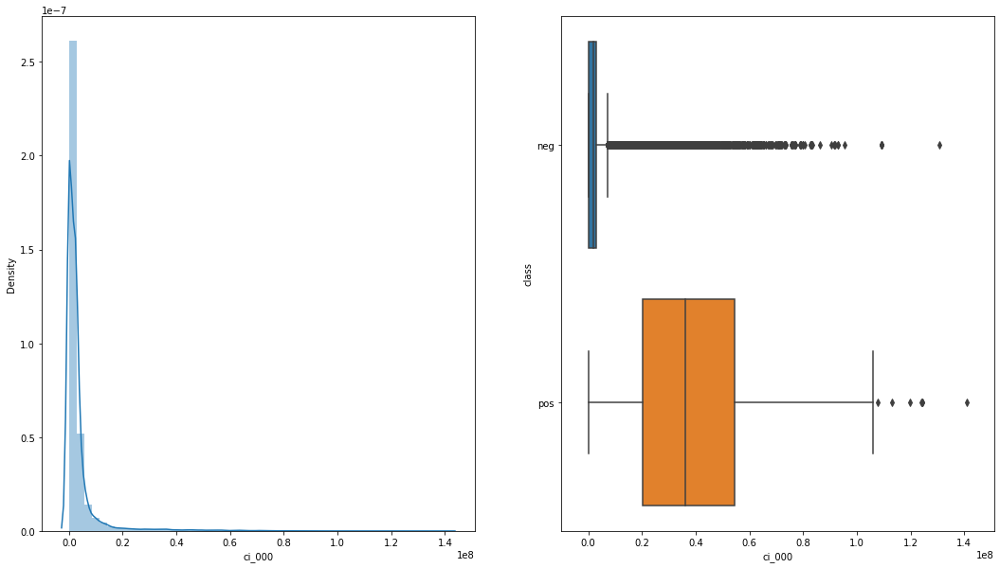

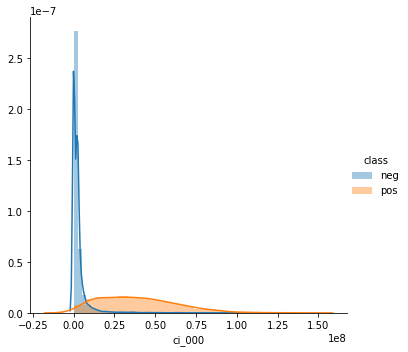

In [28]:
EDA(data.ci_000,'ci_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 

Skew Dist    : 7.87783819933435
Kurtosis Dist: 83.41271212149684
Mean         : 442404.46432478837
Std-dev      : 1262458.2697600161


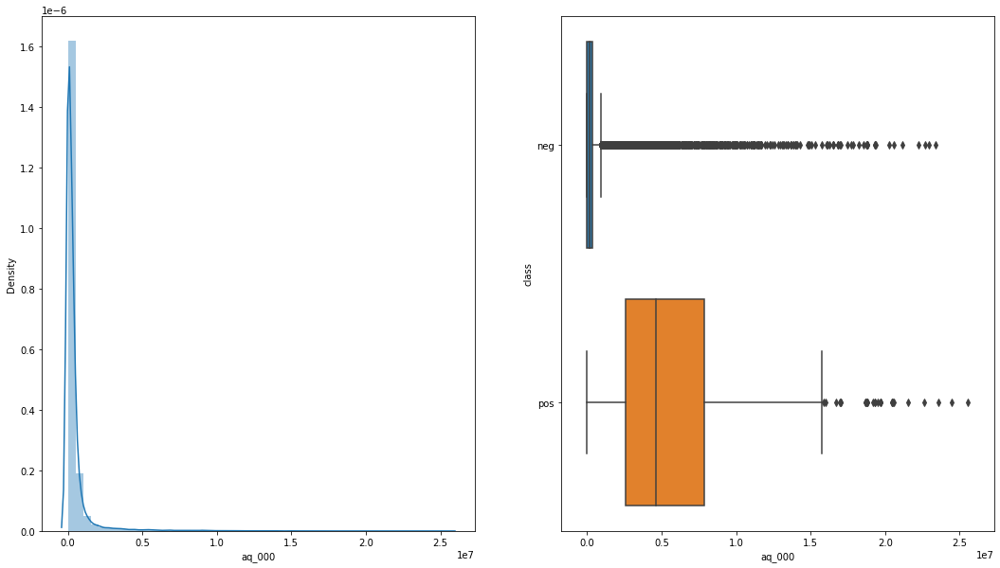

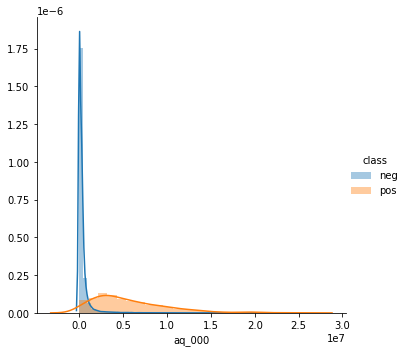

In [29]:
EDA(data.aq_000,'aq_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 

Skew Dist    : 5.870093771169788
Kurtosis Dist: 43.654278149238614
Mean         : 4526177.187802207
Std-dev      : 10886644.92195377


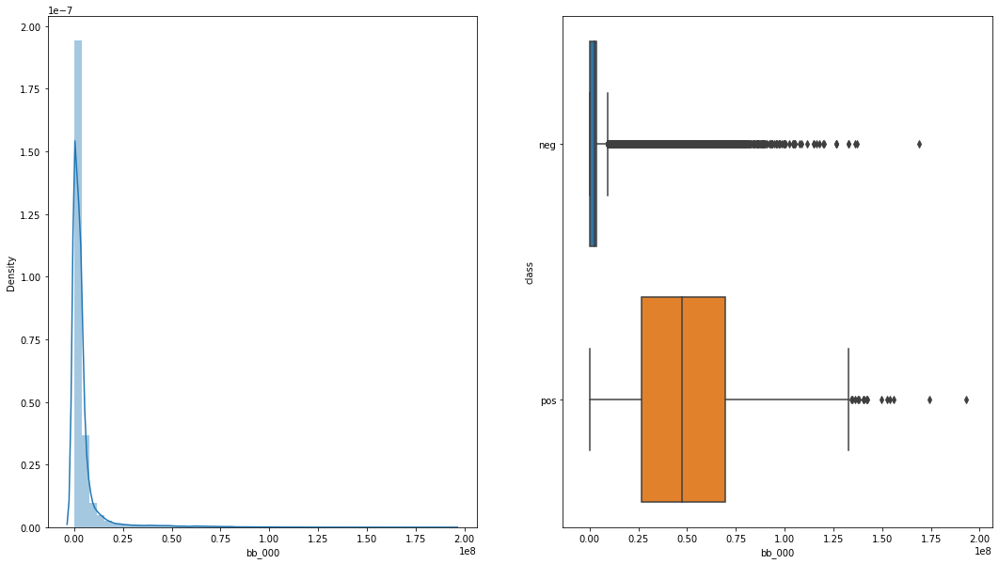

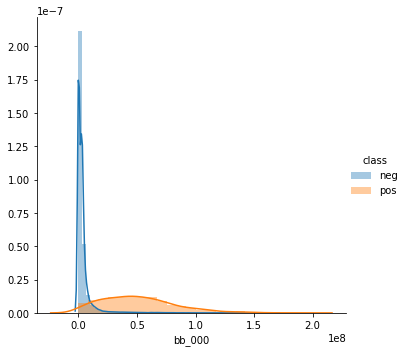

In [30]:
EDA(data.bb_000,'bb_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 

Skew Dist    : 5.87814069028433
Kurtosis Dist: 43.82909379803299
Mean         : 4515325.180023268
Std-dev      : 10859812.536692042


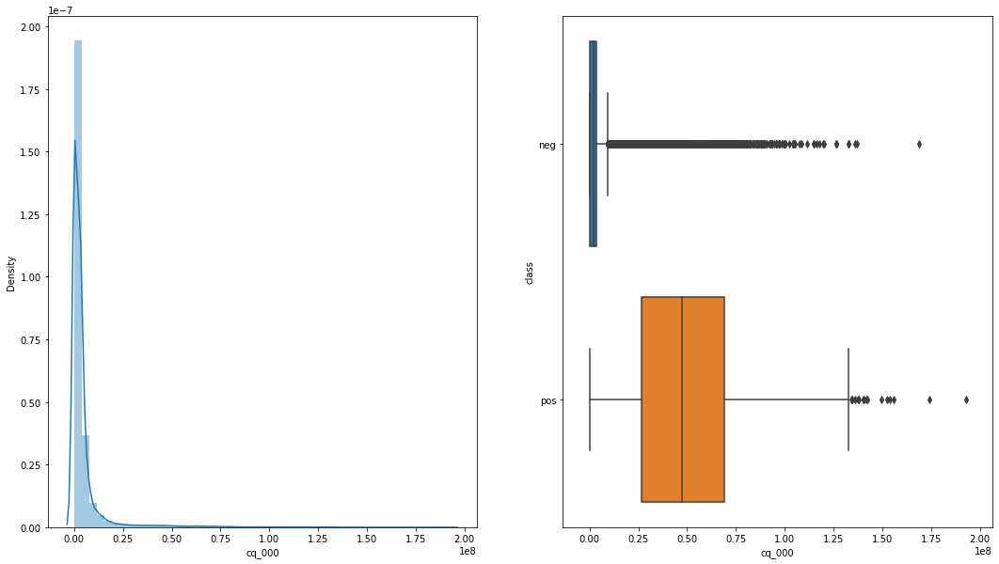

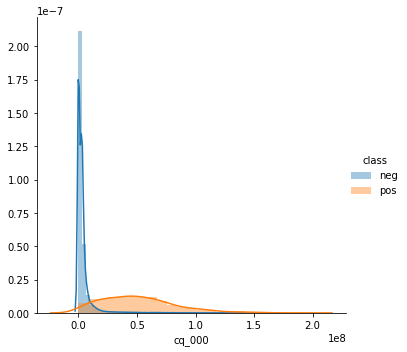

In [31]:
EDA(data.cq_000,'cq_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 

Skew Dist    : 5.878140944889595
Kurtosis Dist: 43.82909786403321
Mean         : 4515324.704715979
Std-dev      : 10859812.286525175


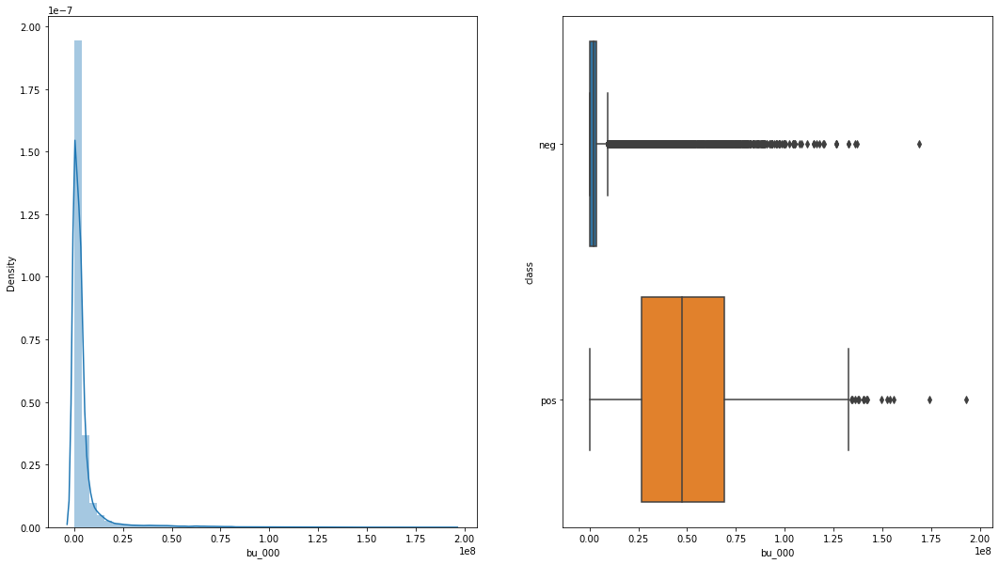

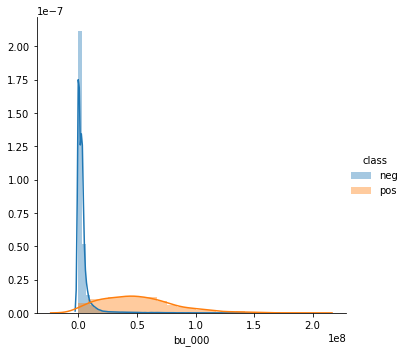

In [32]:
EDA(data.bu_000,'bu_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 

Skew Dist    : 5.878140555033432
Kurtosis Dist: 43.829090105802464
Mean         : 4515325.287831526
Std-dev      : 10859812.948435431


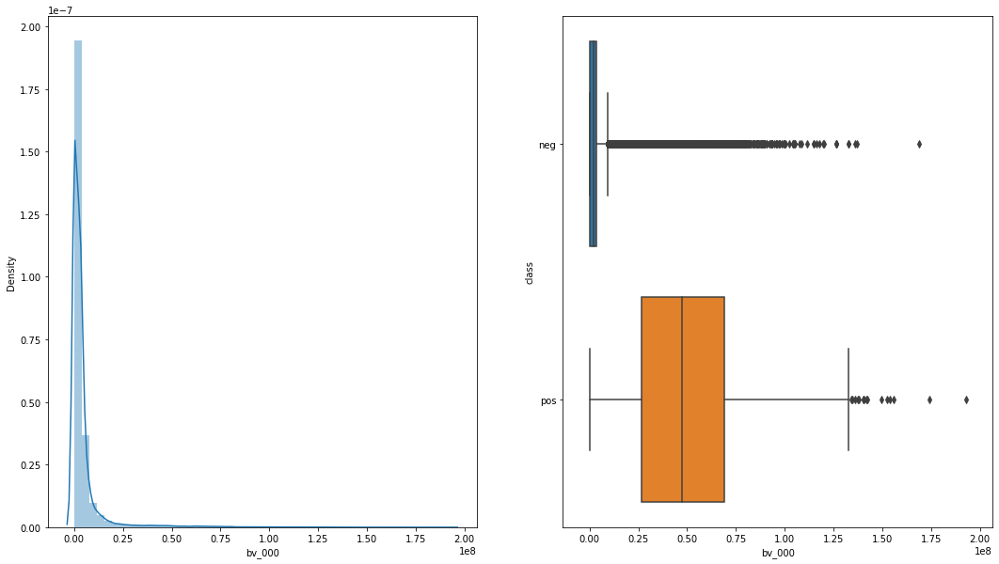

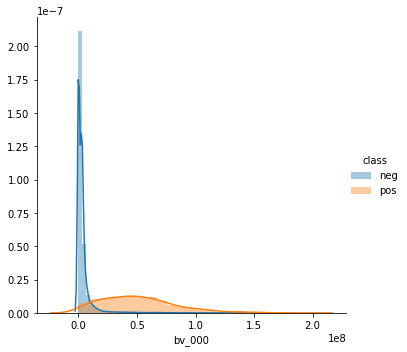

In [33]:
EDA(data.bv_000,'bv_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 

Skew Dist    : 9.699980376452517
Kurtosis Dist: 129.7815414213665
Mean         : 510089.2305465318
Std-dev      : 1820089.5939223832


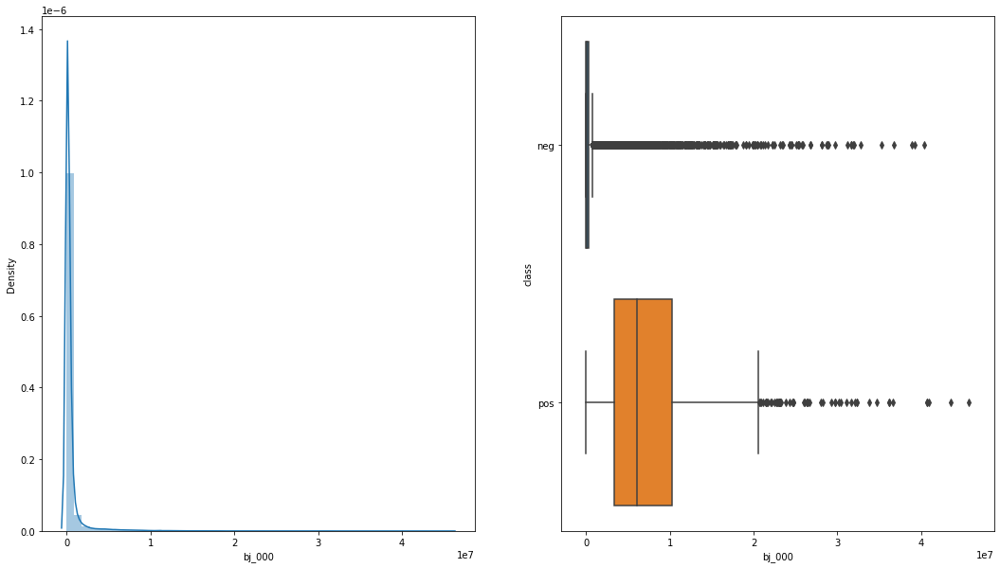

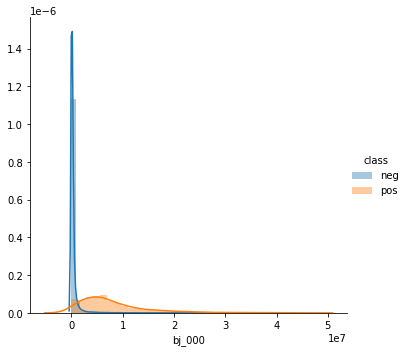

In [34]:
EDA(data.bj_000,'bj_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 

Skew Dist    : 6.118994356901087
Kurtosis Dist: 48.349006446981065
Mean         : 59416.504414787116
Std-dev      : 145445.22192095238


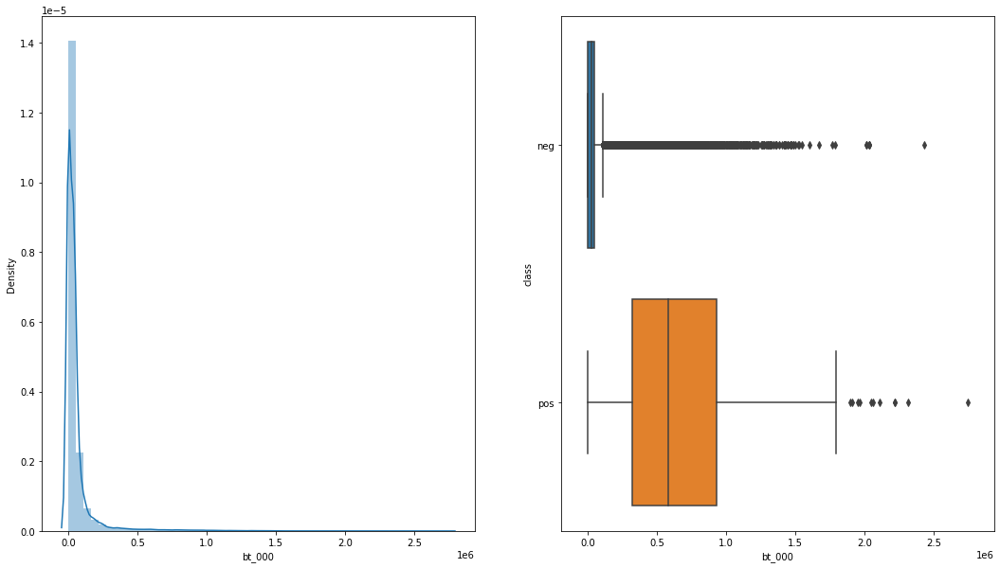

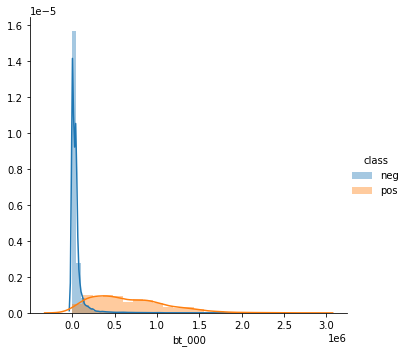

In [35]:
EDA(data.bt_000,'bt_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 

Skew Dist    : 6.115752483633429
Kurtosis Dist: 48.29744108861675
Mean         : 59336.499566666665
Std-dev      : 145428.84460941362


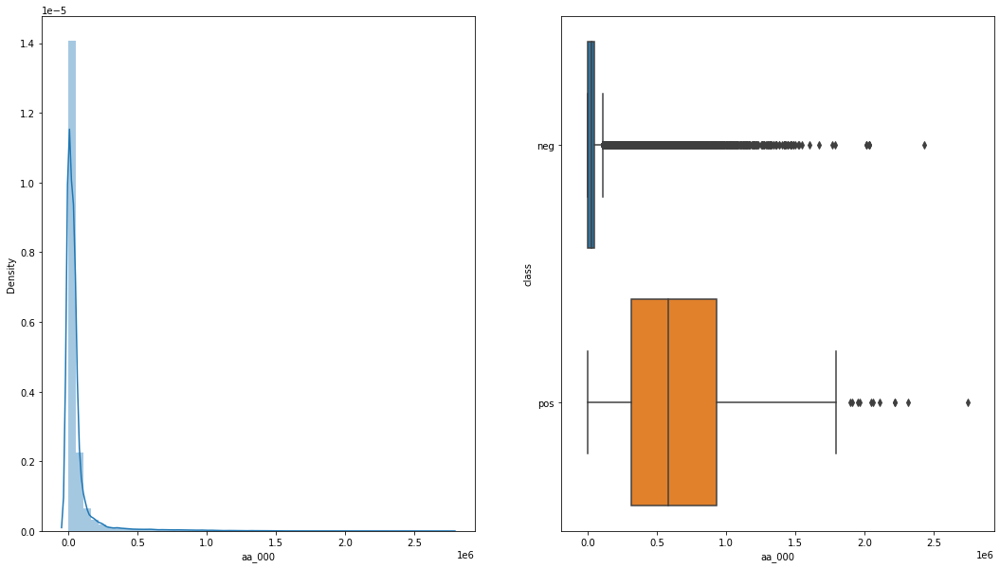

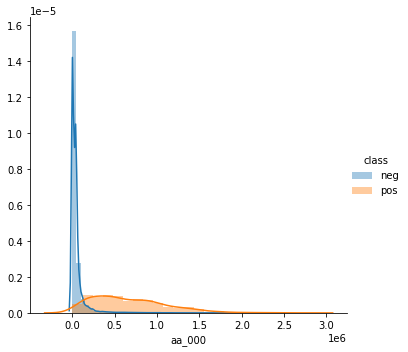

In [36]:
EDA(data.aa_000,'aa_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 

Skew Dist    : 6.355293277597199
Kurtosis Dist: 50.3463115653065
Mean         : 3803443.5634857696
Std-dev      : 9625587.429590397


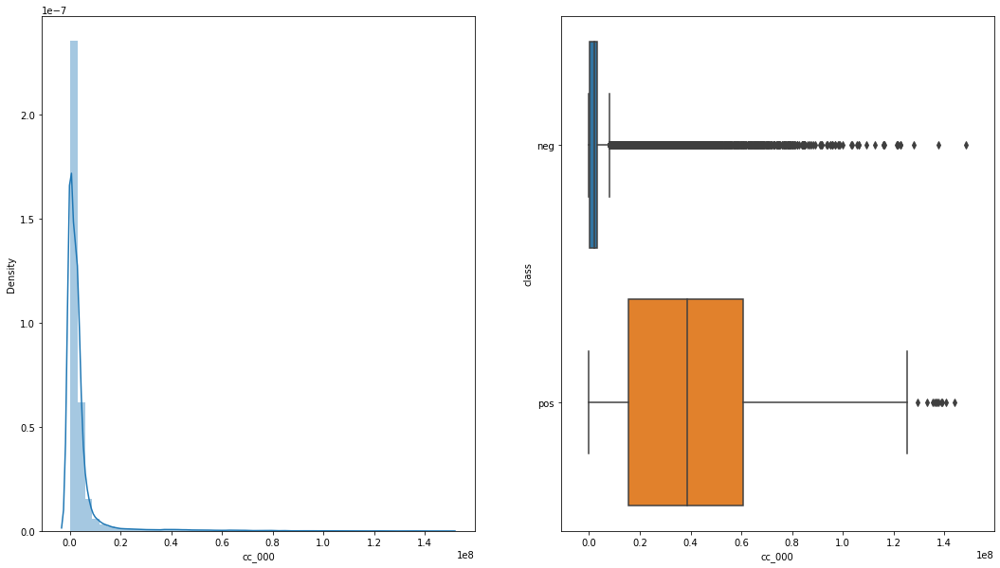

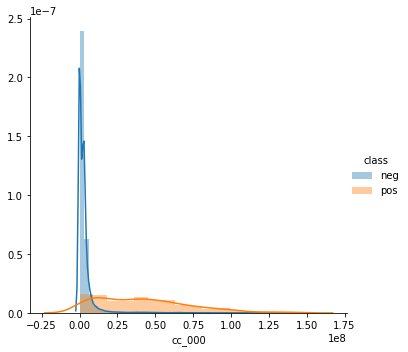

In [37]:
EDA(data.cc_000,'cc_000')

Skew Dist    : 5.668929156683823
Kurtosis Dist: 41.33756568417306
Mean         : 3002440.306946525
Std-dev      : 6819460.997853249


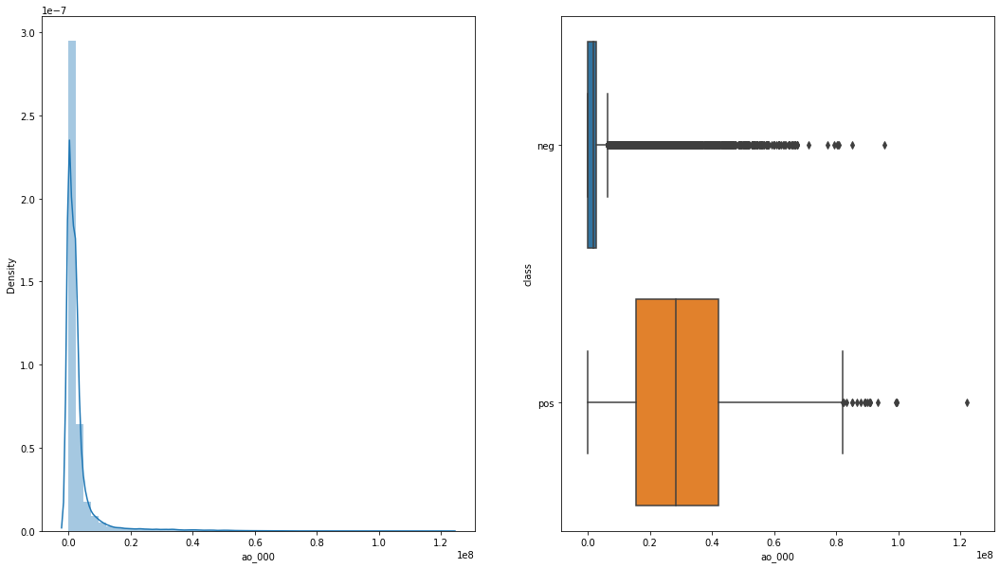

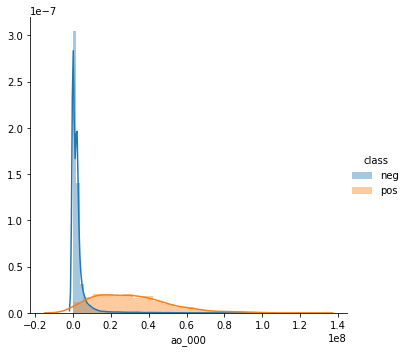

In [38]:
EDA(data.ao_000,'ao_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 
* 90 % neg data point are below than the 0.2

Skew Dist    : 6.324345032219356
Kurtosis Dist: 50.01530449686252
Mean         : 4112218.096893009
Std-dev      : 10351447.281259991


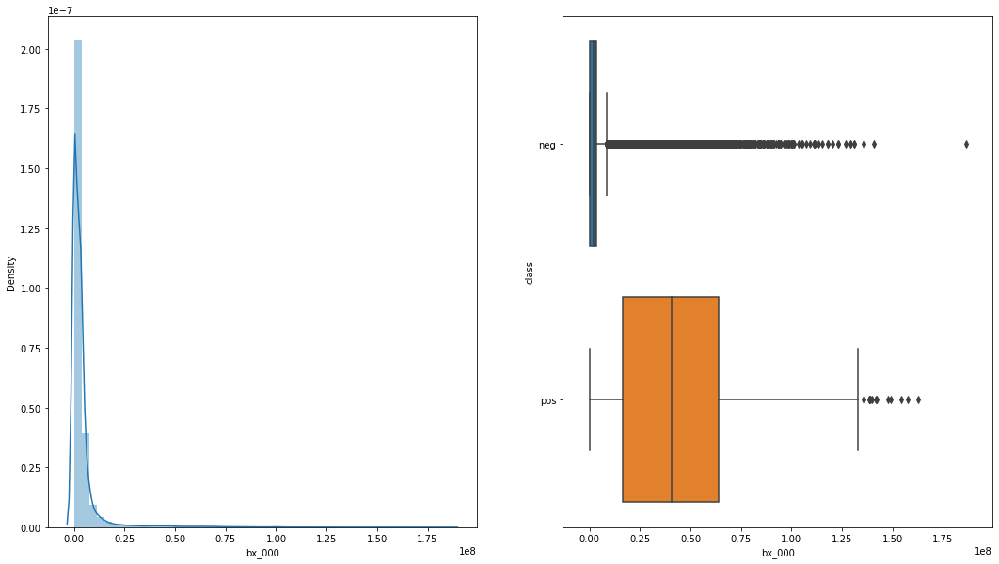

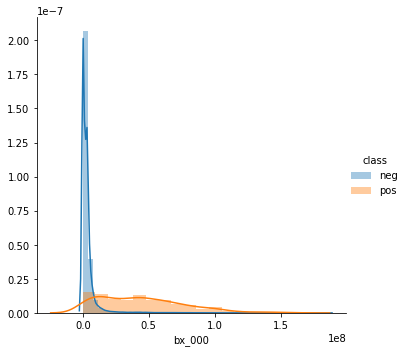

In [39]:
EDA(data.bx_000,'bx_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 

Skew Dist    : 6.801442568917349
Kurtosis Dist: 63.23003482173449
Mean         : 57943.08221301257
Std-dev      : 152208.03896099696


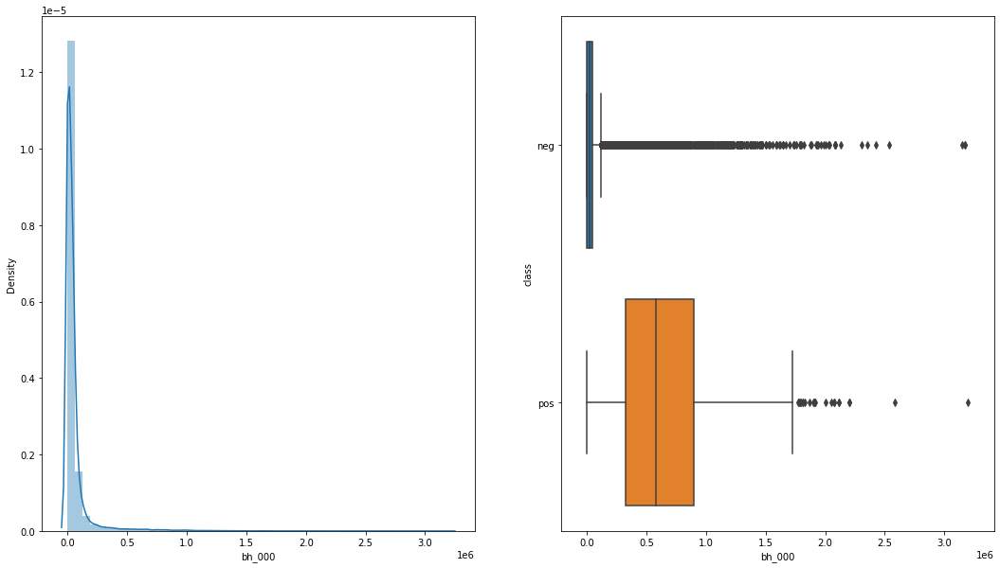

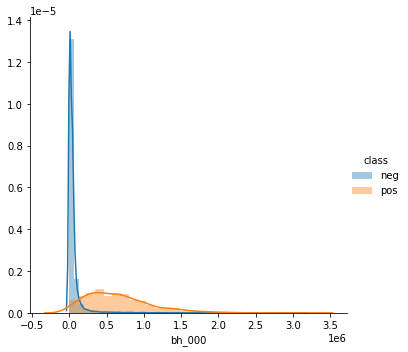

In [40]:
EDA(data.bh_000,'bh_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 
* range of neg class is mostly less than 0.3

Skew Dist    : 7.807262184400477
Kurtosis Dist: 81.67357396443009
Mean         : 1004159.5569594663
Std-dev      : 3088431.018957874


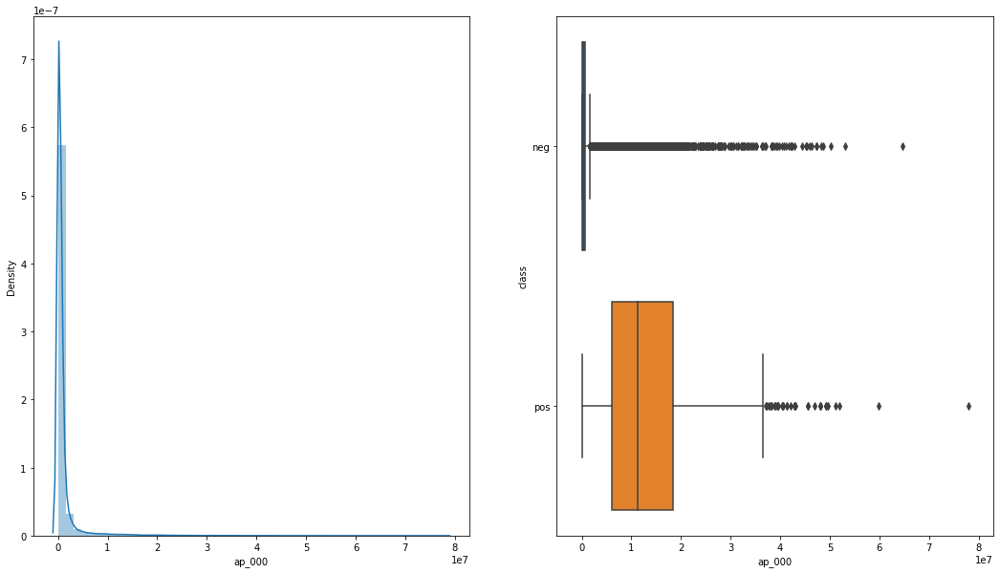

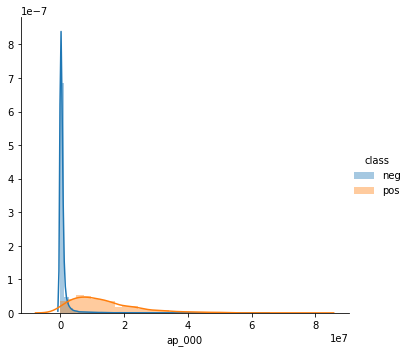

In [41]:
EDA(data.ap_000,'ap_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 
* range of neg class is mostly less than 0.3

Skew Dist    : 6.974825247335402
Kurtosis Dist: 65.41624438983878
Mean         : 22028.93335797201
Std-dev      : 53992.37122064625


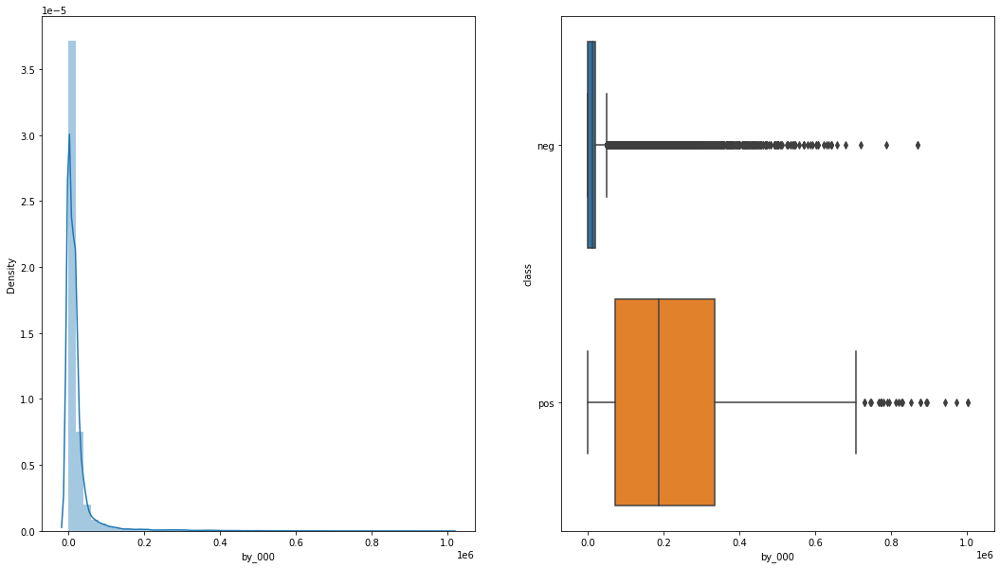

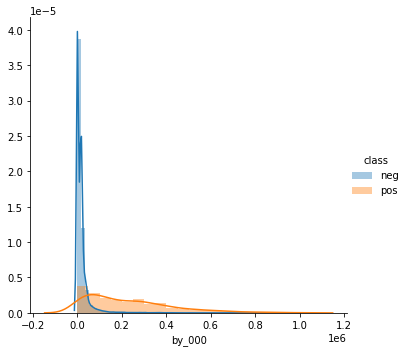

In [42]:
EDA(data.by_000,'by_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 
* range of neg class is mostly less than 0.1

Skew Dist    : 14.555777045121376
Kurtosis Dist: 390.77780425267366
Mean         : 393946.1979807514
Std-dev      : 1121034.9589538286


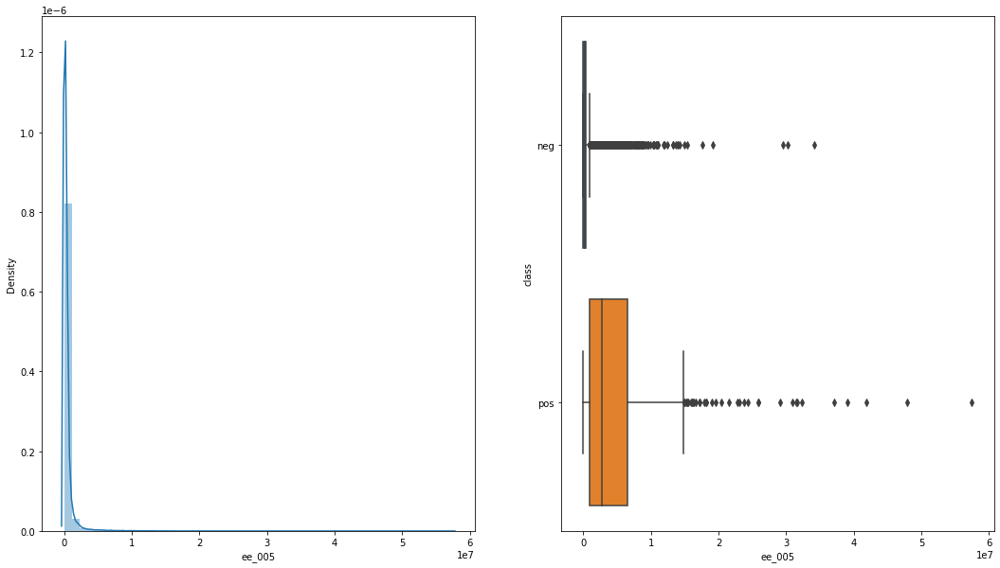

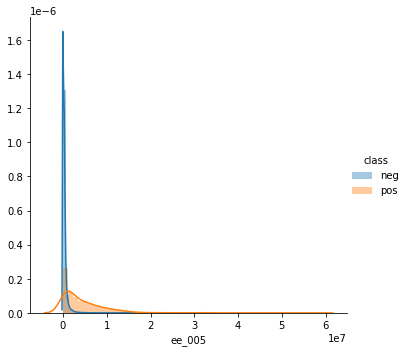

In [43]:
EDA(data.ee_005,'ee_005')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 
* range of neg class is mostly less than 0.2

Skew Dist    : 7.053782942840553
Kurtosis Dist: 72.41925822721566
Mean         : 15403.354669739669
Std-dev      : 33800.72788692232


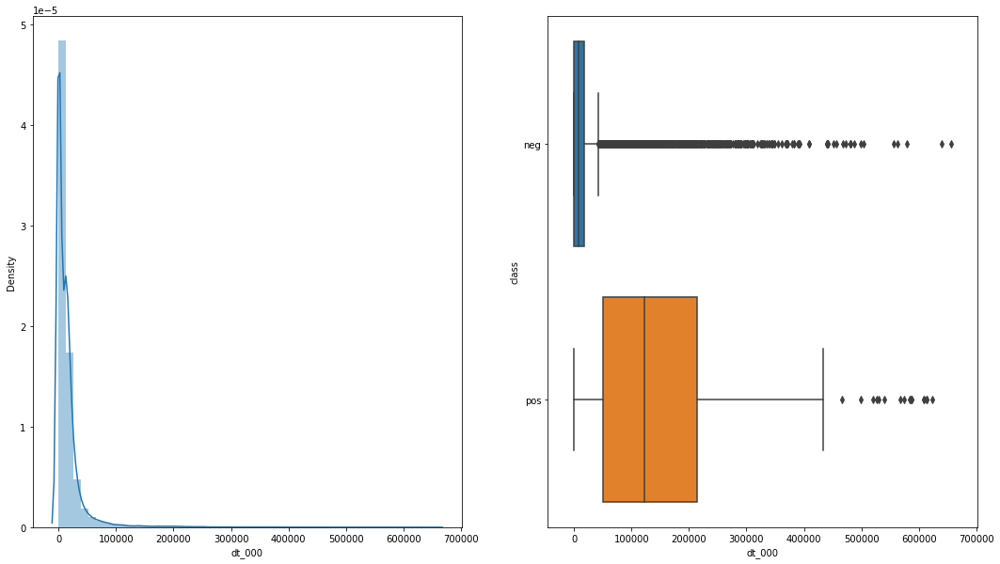

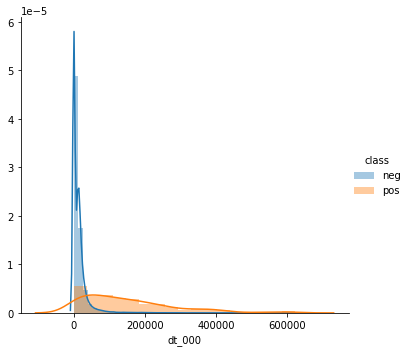

In [44]:
EDA(data.dt_000,'dt_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 
* range of neg class is mostly less than 5000

Skew Dist    : 9.811978667551383
Kurtosis Dist: 164.46651730548814
Mean         : 188941.18940517938
Std-dev      : 509262.88634434657


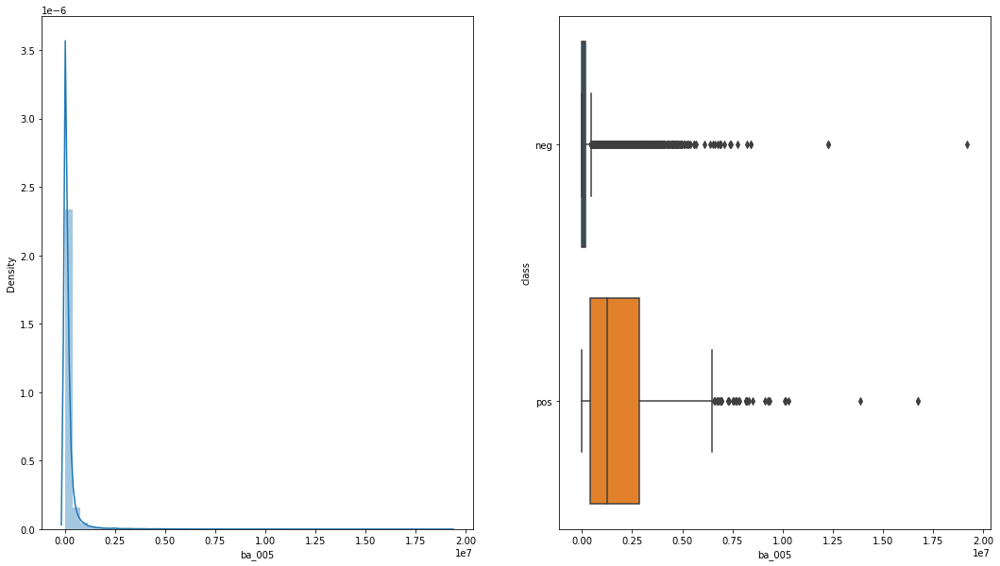

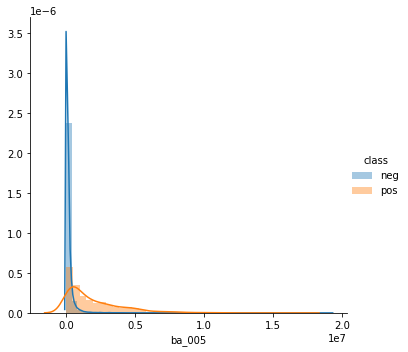

In [45]:
EDA(data.ba_005,'ba_005')

Skew Dist    : 9.198927541361796
Kurtosis Dist: 131.76960915235196
Mean         : 492207.57287371025
Std-dev      : 1485172.0072140254


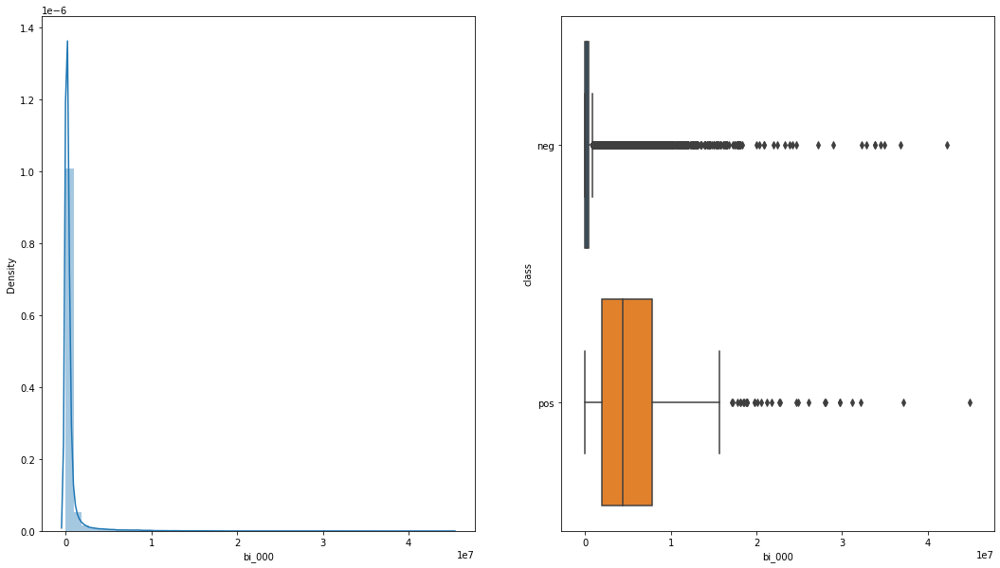

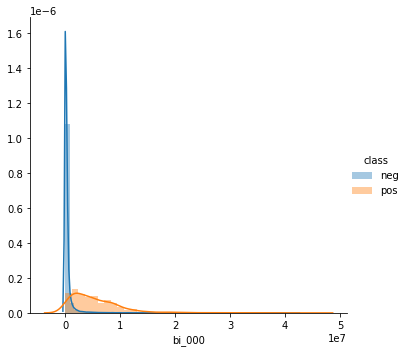

In [46]:
EDA(data.bi_000,'bi_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 
* range of neg class is mostly less than 0.2

Skew Dist    : 8.9201627125974
Kurtosis Dist: 173.14740307837513
Mean         : 1282835.1424814123
Std-dev      : 3357226.0359253665


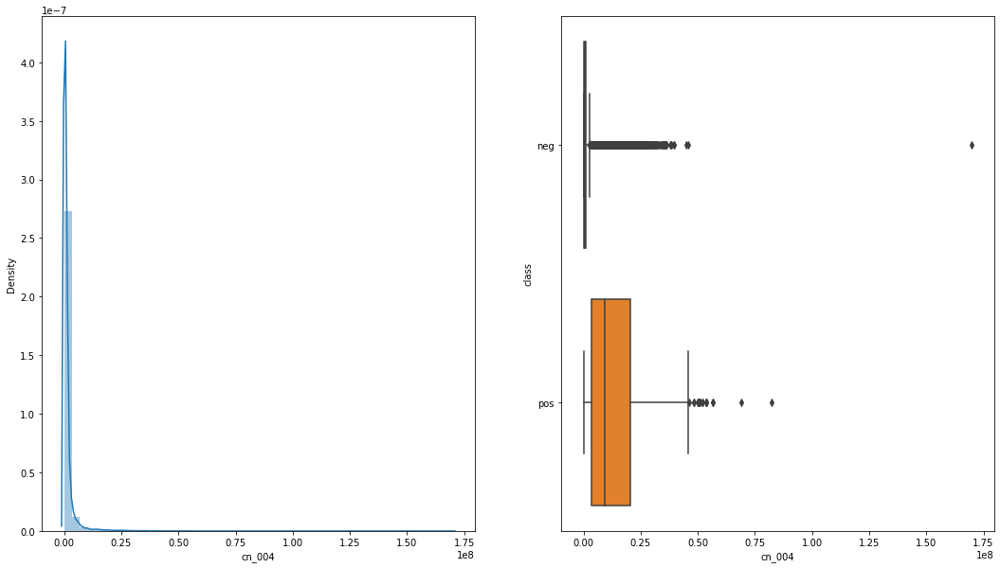

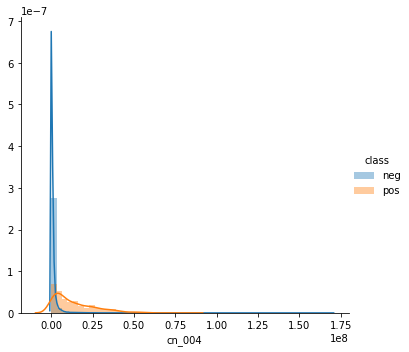

In [47]:
EDA(data.cn_004,'cn_004')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 


Skew Dist    : 8.815512491816088
Kurtosis Dist: 107.99278920548183
Mean         : 1452.155212401134
Std-dev      : 3524.993713764263


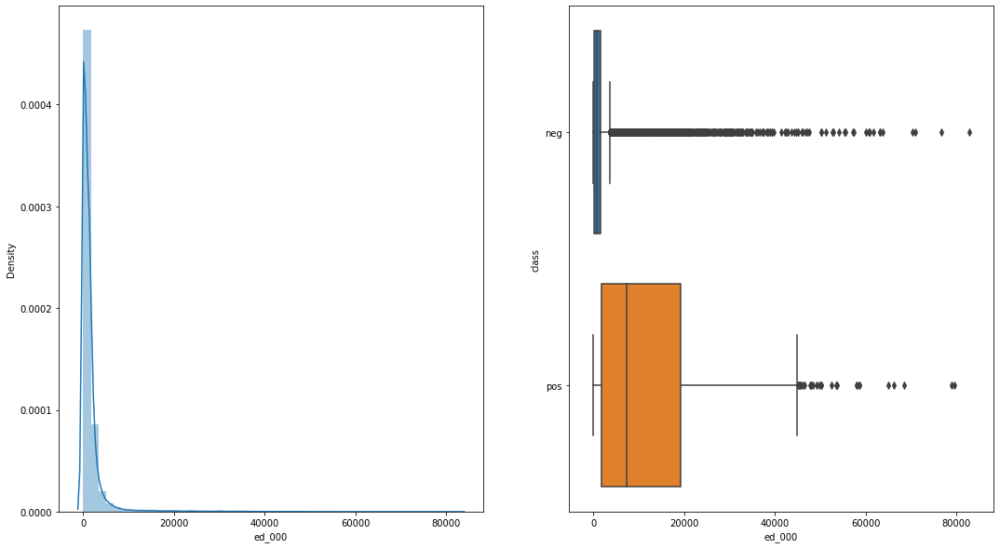

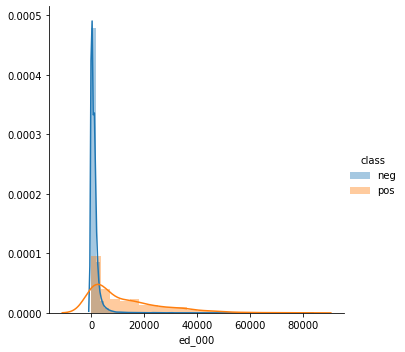

In [48]:
EDA(data.ed_000,'ed_000')

# Observation
* the range of neg class is much lower than the postive class
* range of neg class is mostly less than 5000

Skew Dist    : 5.568640359723724
Kurtosis Dist: 39.40827246768601
Mean         : 3461037.0434987703
Std-dev      : 7790284.106562337


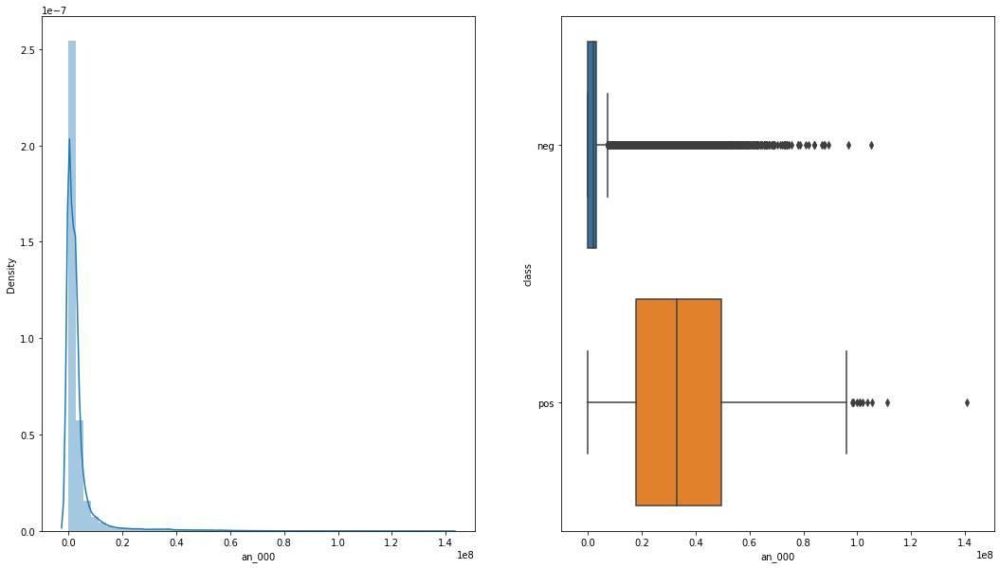

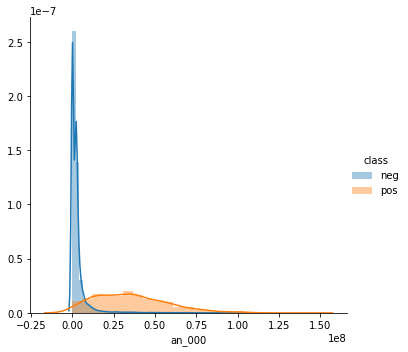

In [49]:
EDA(data.an_000,'an_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 
* range of neg class is mostly less than 0.25

Skew Dist    : 5.534549192024902
Kurtosis Dist: 38.06354053629009
Mean         : 1809931.1761098476
Std-dev      : 4185704.873544476


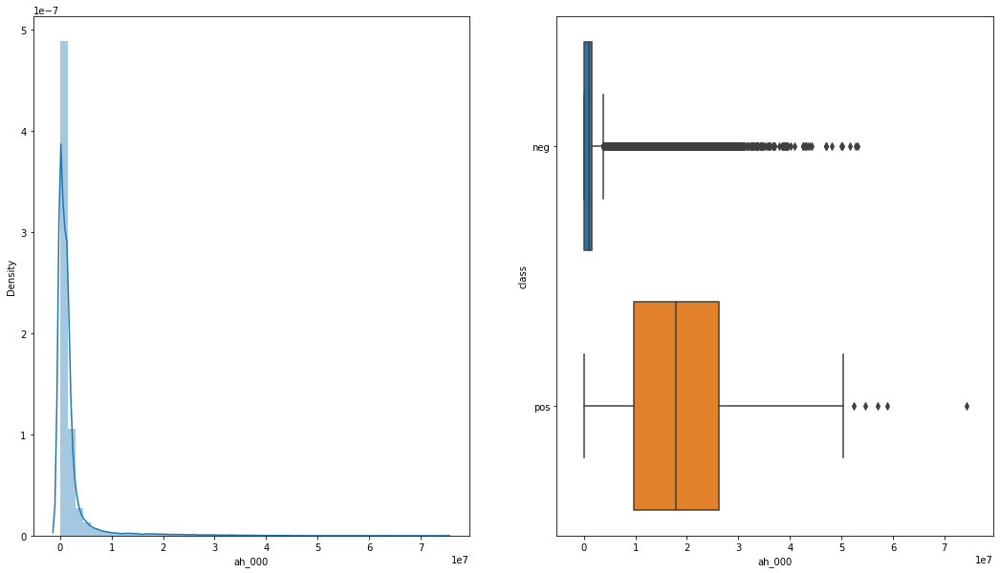

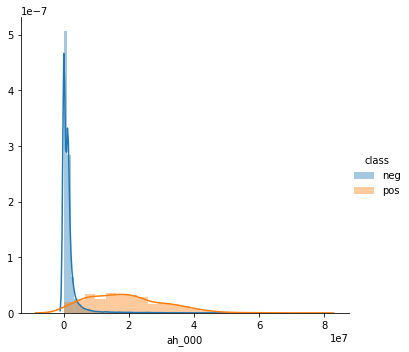

In [50]:
EDA(data.ah_000,'ah_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 
* range of neg class is mostly less than 0.5

Skew Dist    : 5.534854018691377
Kurtosis Dist: 38.1069465011676
Mean         : 1809430.9845345193
Std-dev      : 4180164.565043624


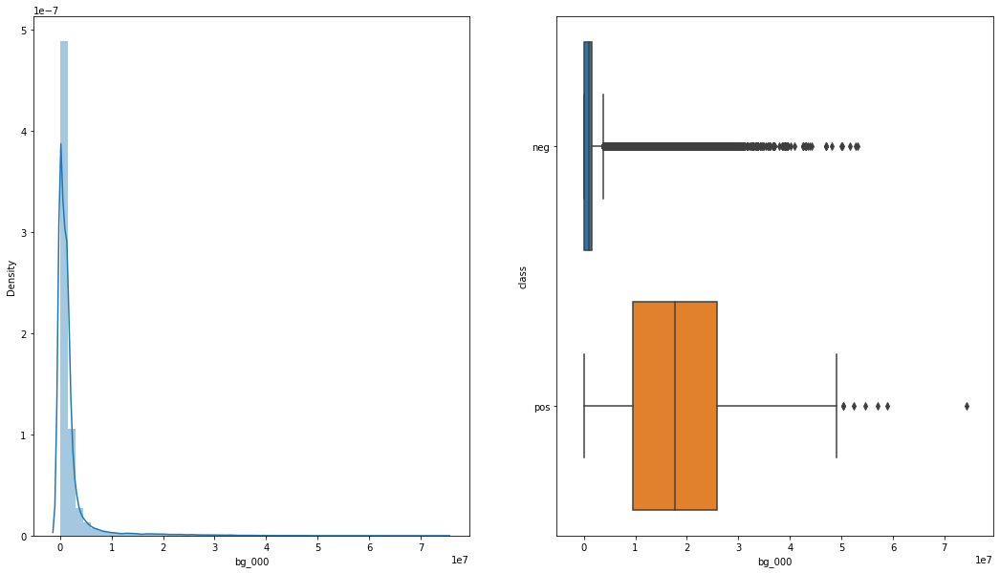

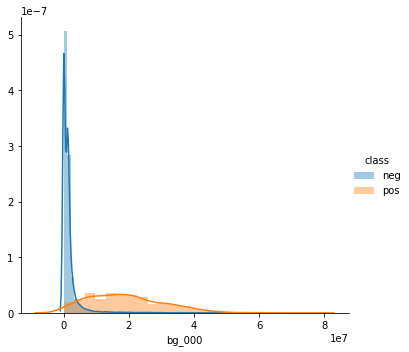

In [51]:
EDA(data.bg_000,'bg_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 
* range of neg class is mostly less than 0.5

Skew Dist    : 10.599929827118538
Kurtosis Dist: 160.44235228123387
Mean         : 733404.2128132953
Std-dev      : 2416145.293050484


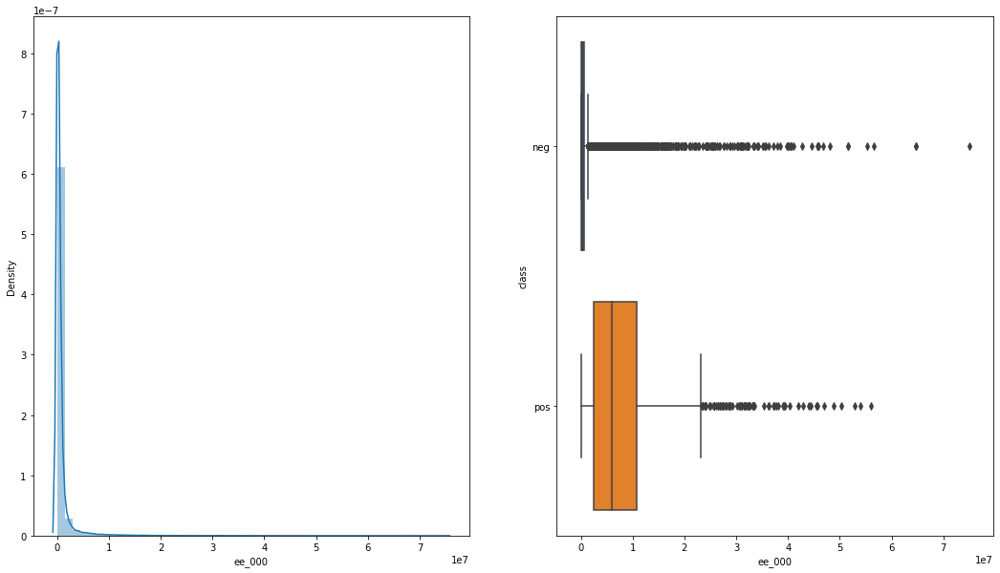

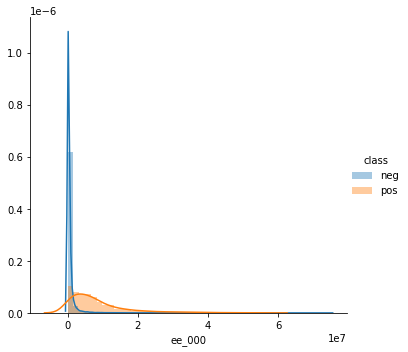

In [52]:
EDA(data.ee_000,'ee_000')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 
* range of neg class is mostly less than 0.3

Skew Dist    : 10.296743303081483
Kurtosis Dist: 159.27265035789426
Mean         : 333058.240388343
Std-dev      : 1069150.6863446236


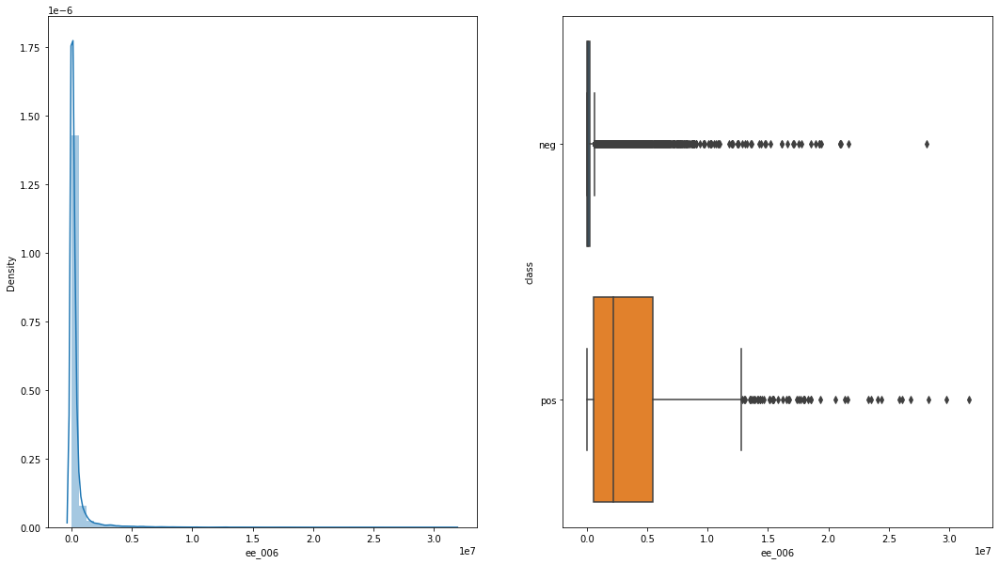

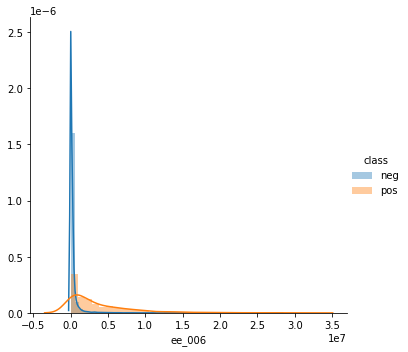

In [53]:
EDA(data.ee_006,'ee_006')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 
* range of neg class is mostly less than 0.2

Skew Dist    : 9.657899076456031
Kurtosis Dist: 132.02092339268398
Mean         : 1051122.964047936
Std-dev      : 3991015.895357171


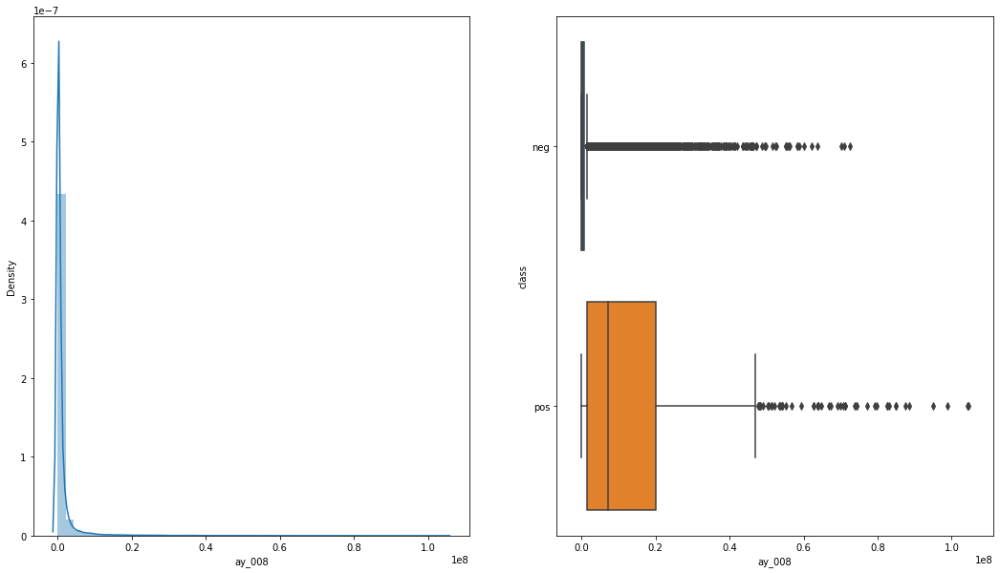

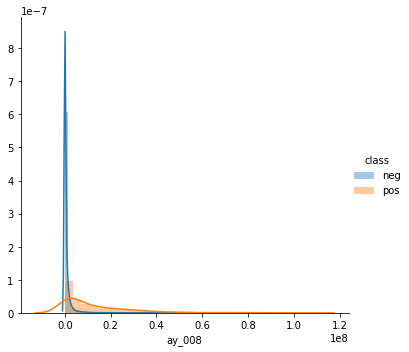

In [54]:
EDA(data.ay_008,'ay_008')

# Observation
* the range of neg class is much lower than the postive class
* neg class has high skewness in the histogram than the postive class 
* range of neg class is mostly less than 0.1

# Bivariate Analysis

In [55]:
newdata = data[important_columns]
newdata.head()

,ci_000,bb_000,bv_000,bu_000,cq_000,bt_000,aa_000,aq_000,bj_000,ah_000,an_000,bg_000,ao_000,cc_000,ap_000,bx_000,by_000,bh_000,dn_000,ee_005,ba_004,cn_004,ck_000,ba_003,ba_005,ag_005,ee_002,cs_005,ba_001,cs_004,ag_003,az_005,ba_000,ee_003,bi_000,ba_002,dt_000,ds_000,ee_004,ee_006,ee_000,ay_008,cn_003
0,5245752.00,6700214.0,6700214.0,6700214.0,6700214.0,76698.08,76698,1132040.0,799478.0,2551696.0,4933296.0,2551696.0,3655166.0,6167850.0,1766008.0,6599892.0,43566.0,97518.0,62282.0,469792.0,310246.0,1309472.0,916567.68,287230.0,681504.0,1432864.0,1240520.0,4015854.0,1022304.0,428776.0,0.0,5526276.0,2328746.0,493384.0,947550.0,415432.0,37928.0,202710.0,721044.0,339156.0,965866.0,755876.0,118196.0
1,2291079.36,3646660.0,3646660.0,3646660.0,3646660.0,33057.51,33058,338544.0,392208.0,1393352.0,2560898.0,1393352.0,2127150.0,2942850.0,1084598.0,3582034.0,17733.0,49028.0,33736.0,245416.0,137280.0,1179502.0,643536.96,154298.0,138668.0,653294.0,421400.0,1837600.0,447166.0,272956.0,0.0,1873902.0,1378576.0,178064.0,688314.0,199512.0,16254.0,103330.0,293306.0,133654.0,664504.0,99560.0,98644.0
2,2322692.16,2673338.0,2673338.0,2673338.0,2673338.0,41040.08,41040,153698.0,139730.0,1234132.0,2371990.0,1234132.0,2173634.0,2560566.0,300796.0,2678534.0,15439.0,28804.0,13876.0,409564.0,189596.0,1215280.0,236099.52,254892.0,135758.0,370592.0,277378.0,1744838.0,672026.0,100326.0,0.0,710672.0,790690.0,159812.0,160176.0,332340.0,10534.0,65772.0,423992.0,320746.0,262032.0,1450312.0,33276.0
3,2135.04,21614.0,21614.0,21614.0,21614.0,12.69,12,1014.0,3090.0,2668.0,10184.0,2668.0,7554.0,7710.0,10764.0,21772.0,32.0,184.0,232.0,44.0,74.0,2170.0,4525.44,102.0,406.0,3232.0,240.0,4836.0,340.0,692.0,318.0,2478.0,6176.0,46.0,7632.0,304.0,18.0,48.0,58.0,10.0,5670.0,5596.0,1894.0
4,3565684.80,4289260.0,4289260.0,4289260.0,4289260.0,60874.03,60874,551022.0,399410.0,1974038.0,3230626.0,1974038.0,2618878.0,3946944.0,1058136.0,4283332.0,24793.0,86454.0,44946.0,347188.0,182278.0,2497104.0,379111.68,236540.0,151778.0,1966618.0,622012.0,2288268.0,1035668.0,186242.0,0.0,3911734.0,1348578.0,229790.0,653692.0,338762.0,35154.0,149474.0,405298.0,286954.0,404740.0,584074.0,378910.0


# Correlation Matrix

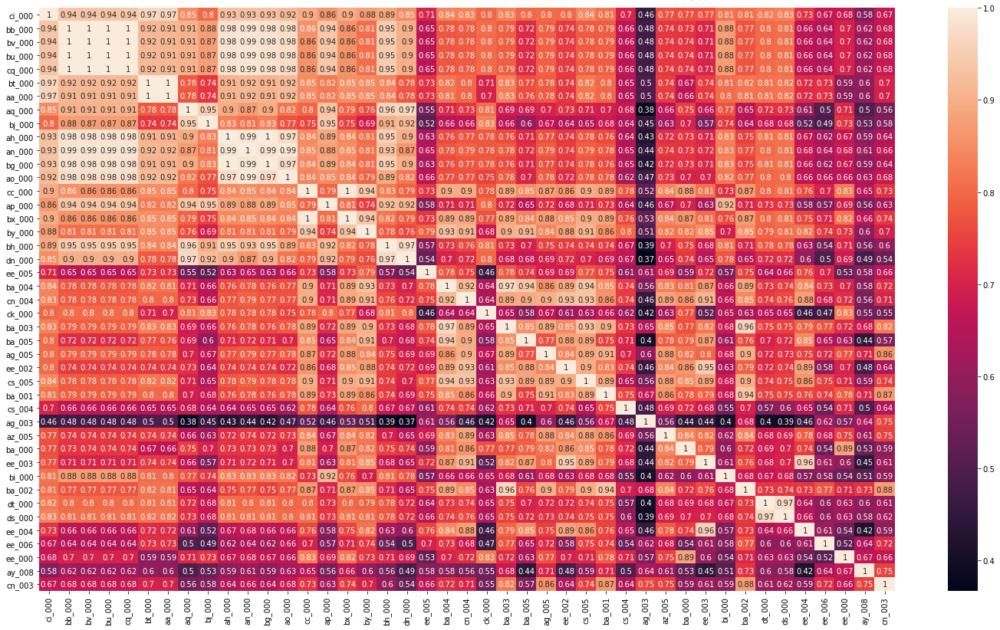

In [56]:
plt.figure(figsize=(25, 14))
vg_corr = newdata.corr()
sns.heatmap(vg_corr, xticklabels = vg_corr.columns.values,yticklabels = vg_corr.columns.values,annot = True);
plt.show()

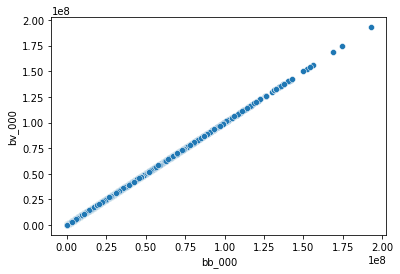

In [57]:
sns.scatterplot(data.bb_000,data.bv_000)

In [58]:
 data = df[important_columns2]
 data['class'] = df['class']
 data.head()

,ci_000,aq_000,bb_000,cq_000,bu_000,bv_000,bj_000,bt_000,aa_000,cc_000,ao_000,bx_000,bh_000,ap_000,ck_000,dn_000,by_000,ee_005,dt_000,bi_000,ba_005,cn_004,ed_000,an_000,ah_000,bg_000,ee_000,ee_006,ay_008,class
0,5245752.00,1132040.0,6700214.0,6700214.0,6700214.0,6700214.0,799478.0,76698.08,76698,6167850.0,3655166.0,6599892.0,97518.0,1766008.0,916567.68,62282.0,43566.0,469792.0,37928.0,947550.0,681504.0,1309472.0,2712.0,4933296.0,2551696.0,2551696.0,965866.0,339156.0,755876.0,neg
1,2291079.36,338544.0,3646660.0,3646660.0,3646660.0,3646660.0,392208.0,33057.51,33058,2942850.0,2127150.0,3582034.0,49028.0,1084598.0,643536.96,33736.0,17733.0,245416.0,16254.0,688314.0,138668.0,1179502.0,2334.0,2560898.0,1393352.0,1393352.0,664504.0,133654.0,99560.0,neg
2,2322692.16,153698.0,2673338.0,2673338.0,2673338.0,2673338.0,139730.0,41040.08,41040,2560566.0,2173634.0,2678534.0,28804.0,300796.0,236099.52,13876.0,15439.0,409564.0,10534.0,160176.0,135758.0,1215280.0,1020.0,2371990.0,1234132.0,1234132.0,262032.0,320746.0,1450312.0,neg
3,2135.04,1014.0,21614.0,21614.0,21614.0,21614.0,3090.0,12.69,12,7710.0,7554.0,21772.0,184.0,10764.0,4525.44,232.0,32.0,44.0,18.0,7632.0,406.0,2170.0,54.0,10184.0,2668.0,2668.0,5670.0,10.0,5596.0,neg
4,3565684.80,551022.0,4289260.0,4289260.0,4289260.0,4289260.0,399410.0,60874.03,60874,3946944.0,2618878.0,4283332.0,86454.0,1058136.0,379111.68,44946.0,24793.0,347188.0,35154.0,653692.0,151778.0,2497104.0,1176.0,3230626.0,1974038.0,1974038.0,404740.0,286954.0,584074.0,neg


# Scatter plots

Text(0.5, 1.0, 'Scatter plot of aa_000 and bv_000')

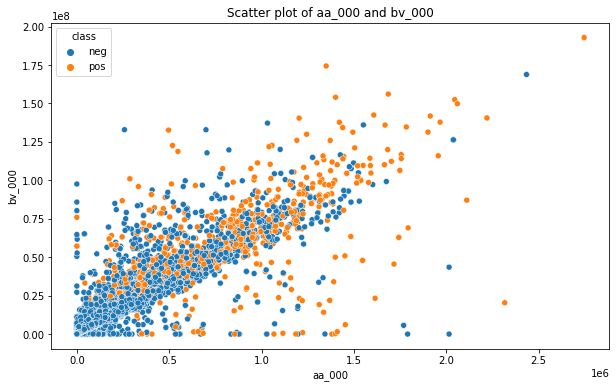

In [59]:
plt.figure(figsize=(10,6))
ax = sns.scatterplot(x='aa_000',y='bv_000',data=data,hue='class')
ax.set_title('Scatter plot of aa_000 and bv_000')

# Observation
* BV_000 having less than 0,25 and aa_000 having the less than 0.5 are mostly negtive class data point

Text(0.5, 1.0, 'Scatter plot of aa_000 and bv_000')

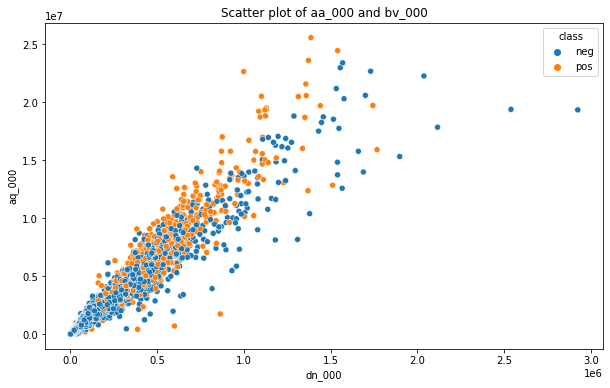

In [60]:
plt.figure(figsize=(10,6))
ax = sns.scatterplot(x='dn_000',y='aq_000',data=data,hue='class')
ax.set_title('Scatter plot of aa_000 and bv_000')

Text(0.5, 1.0, 'Scatter plot of bb_000 and bv_000')

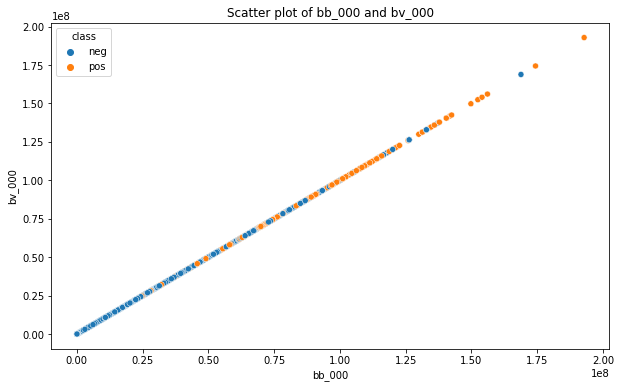

In [61]:
plt.figure(figsize=(10,6))
ax = sns.scatterplot(x='bb_000',y='bv_000',data=data,hue='class')
ax.set_title('Scatter plot of bb_000 and bv_000')

# Observation 
* mostly less than 0.50 data point are negtive class
* above 1.0 are postive class data point

Text(0.5, 1.0, 'Scatter plot of bb_000 and ah_000')

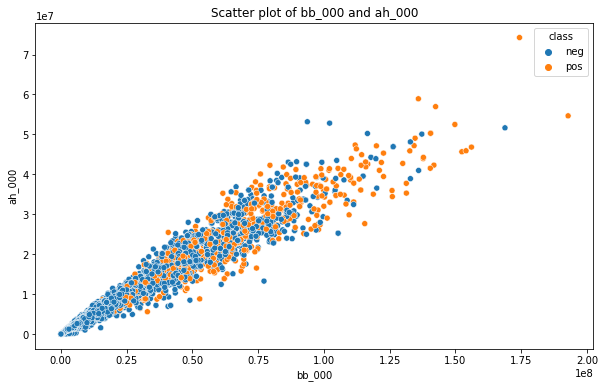

In [62]:
plt.figure(figsize=(10,6))
ax = sns.scatterplot(x='bb_000',y='ah_000',data=data,hue='class')
ax.set_title('Scatter plot of bb_000 and ah_000')

# Observation 
* ah_000 having less tham 1 and bb_000 having less than 0.25 are negetive class data point

Text(0.5, 1.0, 'Scatter plot of bb_000 and ah_000')

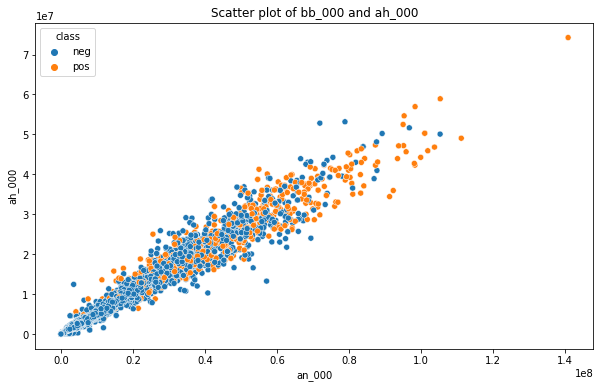

In [63]:
plt.figure(figsize=(10,6))
ax = sns.scatterplot(x='an_000',y='ah_000',data=data,hue='class')
ax.set_title('Scatter plot of bb_000 and ah_000')

# Observation 
* data point having ah_000 less than 1 and an_000 haaving less tham 0.2 are mostly neg class data point

# Pair plot

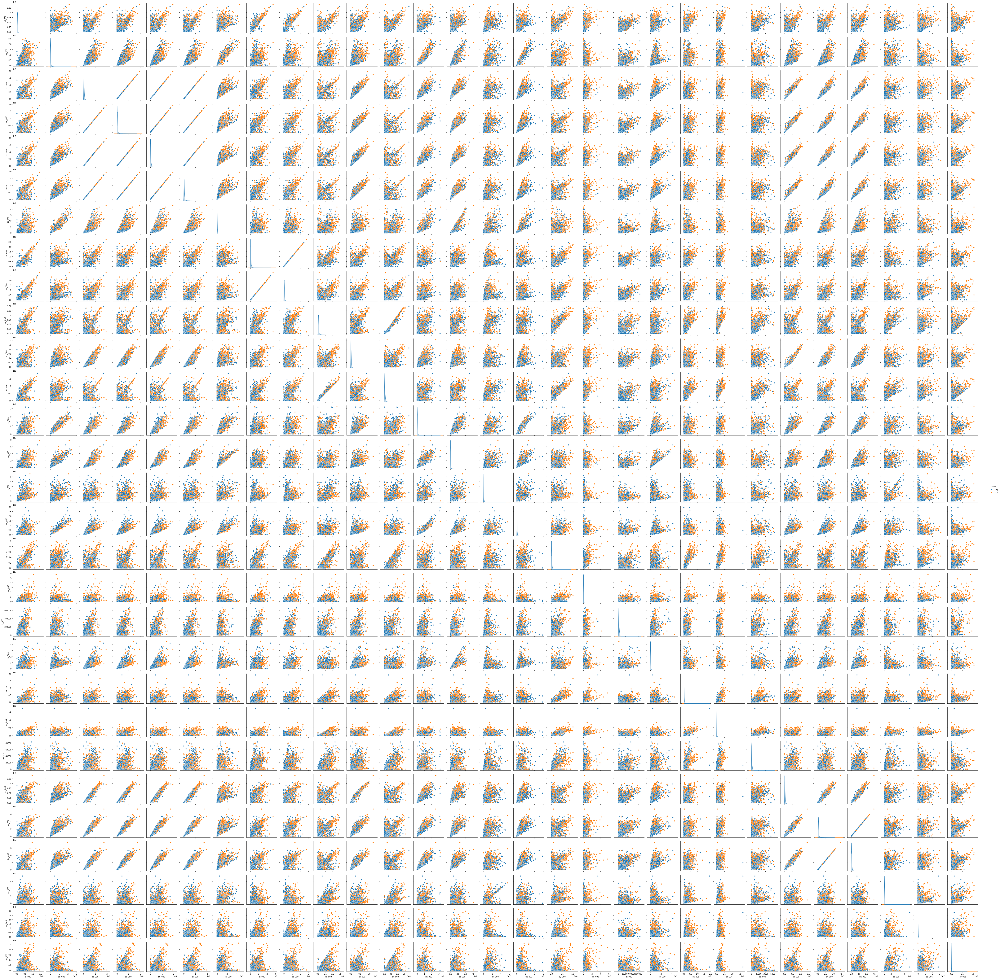

In [64]:
sns.pairplot(data, hue="class")
plt.show()